In [ ]:
# Importing libraries and Setting Dislplay Options

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from bs4 import BeautifulSoup
import requests
import re
from datetime import datetime

import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy
import scipy.stats as stats


from sklearn import linear_model
from sklearn.linear_model import LinearRegression, Ridge, Lasso, LassoCV, RidgeCV
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.metrics import r2_score
from xgboost import XGBRegressor
import lightgbm as lgb
from sklearn import metrics


import tensorflow as tf
import keras
import tensorflow
tensorflow.random.set_seed(1)
from tensorflow.python.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.wrappers.scikit_learn import KerasRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

print(tf.__version__)


import warnings
warnings.filterwarnings('ignore')

#Setting Options
pd.set_option('display.max_columns', 75)
pd.set_option('display.max_rows', 100)

# Load the TensorBoard notebook extension.
%load_ext tensorboard

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


2.6.0


# Scraping Data From sofifa.com

In [ ]:
# Scraping Fifa2020 Player's Detail Characteristics Data from web site

player_list = []

i = 0
while i < 3000:
    url_list = "https://sofifa.com/?showCol[0]=pi&showCol[1]=ae&showCol[2]=hi&showCol[3]=wi&showCol[4]=pf&showCol[5]=oa&showCol[6]=pt&showCol[7]=bo&showCol[8]=bp&showCol[9]=gu&showCol[10]=vl&showCol[11]=wg&showCol[12]=rc&showCol[13]=ta&showCol[14]=cr&showCol[15]=fi&showCol[16]=he&showCol[17]=sh&showCol[18]=vo&showCol[19]=ts&showCol[20]=dr&showCol[21]=cu&showCol[22]=fr&showCol[23]=lo&showCol[24]=bl&showCol[25]=to&showCol[26]=ac&showCol[27]=sp&showCol[28]=ag&showCol[29]=re&showCol[30]=ba&showCol[31]=tp&showCol[32]=so&showCol[33]=ju&showCol[34]=st&showCol[35]=sr&showCol[36]=ln&showCol[37]=te&showCol[38]=ar&showCol[39]=in&showCol[40]=po&showCol[41]=vi&showCol[42]=pe&showCol[43]=cm&showCol[44]=td&showCol[45]=ma&showCol[46]=sa&showCol[47]=sl&showCol[48]=tg&showCol[49]=gd&showCol[50]=gh&showCol[51]=gc&showCol[52]=gp&showCol[53]=gr&showCol[54]=tt&showCol[55]=bs&showCol[56]=ir&showCol[57]=pac&showCol[58]=sho&showCol[59]=pas&showCol[60]=dri&showCol[61]=def&showCol[62]=phy&r=210059&set="+str(i)
    response = requests.get(url_list)
    page = response.text
    soup = BeautifulSoup(page,"lxml")
    rows = soup.find_all("tr")
    for row in rows:
        cells = row.find_all('td')
        cells_to_string = str(cells)
        cells_sub = (re.sub(re.compile('<.*?>'),'',cells_to_string))
        player_list.append(cells_sub)
        result = pd.DataFrame(player_list)
    i += 60

In [ ]:
print("Number of All Rows")
print(len(result));
print("")
print("Number of Rows Without Duplicated")
result.drop_duplicates(subset=None, keep="first", inplace=True)
print(len(result))

Number of All Rows
3050

Number of Rows Without Duplicated
121


In [ ]:
#Saving result data frame as a Pickle File
result.to_pickle("PlayerListInitialPickle")

In [ ]:
#Reading result from Pickle File as a data frame
result = pd.read_pickle("PlayerListInitialPickle")

In [ ]:
# Getting table name (header)
table_players = soup.find("table",attrs={"class":"table table-hover persist-area"})
header_players = table_players.find_all("th")
column_name_players = []
for row in header_players:
    column_name_players.append(row.text)

In [ ]:
# Setting columns names
new_column_name_players = [
 'Name',
 'Age',
 'Overall',
 'Potential',
 'Team',
 'Height',
 'Weight',
 'Foot',
 'Best_Overall',
 'Position',
 'Growth',
 'Value',
 'Wage',
 'Release_Clause',
 'Attacking',
 'Crossing',
 'Finishing',
 'Heading_Accuracy',
 'Short_Passing',
 'Volleys',
 'Skill',
 'Dribbling',
 'Curve',
 'FK_Accuracy',
 'Long_Passing',
 'Ball_Control',
 'Movement',
 'Acceleration',
 'Sprint_Speed',
 'Agility',
 'Reactions',
 'Balance',
 'Power',
 'Shot_Power',
 'Jumping',
 'Stamina',
 'Strength',
 'Long_Shots',
 'Mentality',
 'Aggression',
 'Interceptions',
 'Positioning',
 'Vision',
 'Penalties',
 'Composure',
 'Defending',
 'Marking',
 'Standing_Tackle',
 'Sliding_Tackle',
 'Goalkeeping',
 'GK_Diving',
 'GK_Handling',
 'GK_Kicking',
 'GK_Positioning',
 'GK_Reflexes',
 'Total_Stats',
 'Base_Stats',
 'Int_Reputation',
 'PAC',
 'SHO',
 'PAS',
 'DRI',
 'DEF',
 'PHY']

In [ ]:
len(new_column_name_players)

64

In [ ]:

result = pd.read_pickle("PlayerListInitialPickle")

result = result[0].str.split(',',expand=True)


result[1] = result[1].str.replace("\n ","")

chars_to_remove = ["GK","RB","RCB","CB","LCB","LB","RWB","RDM","CDM","LDM","LWB","RM","RCM","CM","LCM","LM","LAM","CAM","RAM","RW","RF","CF","LF","LW","LS","ST","RS"]
for char in chars_to_remove:
    result[1]=result[1].str.replace(char,"")
    result[1]=result[1].str.lstrip()

result[5] = result[5].str.replace("\n\n\n\n","")
result[5] = result[5].str.split("\n").str[0]
result[5] = result[5].str.strip()

result[6] = result[6].replace(r'Loan', np.nan, regex=True)
result = result.iloc[1:]

result_WoLoan = result[result[6].notna()]

result_WoLoan.drop(result_WoLoan.columns[[0,6,66,67,68]],axis=1, inplace=True)

mask_loan = result[6].isnull()

result_loan = result.loc[mask_loan].shift(-1, axis=1)

result_loan.drop_duplicates(subset=[6], keep="first", inplace=True)

result_loan.drop(result_loan.columns[[5,6,66,67,68]],axis=1, inplace=True)

result_WoLoan.columns = new_column_name_players

result_loan.columns = new_column_name_players

result_master = pd.concat([result_WoLoan,result_loan]).reset_index()
del result_master["index"]

result_master.drop_duplicates(subset=None, keep="first",inplace=True)

In [ ]:
#Cleaning some characters

result_master = result_master[~result_master["Height"].str.contains("~")]
result_master = result_master[~result_master["Age"].str.contains("\n")]
result_master = result_master[result_master["Height"].str.contains("'")]

In [ ]:
#Converting Height column to centimeter

result_master["Height"] = result_master["Height"].str[:-1]

def parse_height(height):
    # format: 5'11"
    height = height.split("'")
    feet = float(height[0])
    inch = float(height[1])
    return ((feet*30.48) + (inch*2.54))

result_master["Height"]=round(result_master["Height"].apply(lambda x:parse_height(x)),0)

In [ ]:
#Converting Weight column to kilogram
result_master["Weight"] = round(result_master["Weight"].str.split("lbs").str[0].astype(float)*0.45359237,0)

In [ ]:
#Cleaning to Value column and convert to decimal
result_master["Value"] = result_master["Value"].str.replace("€","")
result_master["Value"] = result_master["Value"].str.replace("M","")
result_master.loc[result_master["Value"].str.contains("K"),"Value"]=result_master["Value"].str.split("K").str[0].astype(float)/1000
result_master["Value"] = round(result_master["Value"].astype(float),2)
result_master = result_master.loc[result_master["Value"]>0]

In [ ]:
#Cleaning Wage column and convert to decimal
result_master["Wage"] = result_master["Wage"].str.replace("€","")
result_master.loc[result_master["Wage"].str.contains("K"),"Wage"]=result_master["Wage"].str.split("K").str[0].astype(float)*1000
result_master["Wage"] = round(result_master["Wage"].astype(float)/1000000,5)


In [ ]:
#Cleaning Release_Clause column and convert to decimal
result_master["Release_Clause"] = result_master["Release_Clause"].str.replace("€","")
result_master["Release_Clause"] = result_master["Release_Clause"].str.replace("M","")
result_master.loc[result_master["Release_Clause"].str.contains("K"),"Release_Clause"]=result_master["Release_Clause"].str.split("K").str[0].astype(float)/1000
result_master["Release_Clause"] = round(result_master["Release_Clause"].astype(float),2)

In [ ]:
#Checking Height,Weight,Value,Wage and Release_Clause columns
result_master.head(10)

,Name,Age,Overall,Potential,Team,Height,Weight,Foot,Best_Overall,Position,Growth,Value,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY


In [ ]:
result_master.to_csv("FIFA2021.csv", index=False) # Saving the data for future use

In [ ]:
#Deleting some rows that composure columns is blank with blank values
result_master = result_master.loc[result_master["Composure"]!=" "]
result_master = result_master[result_master["Base_Stats"]!=' ']

In [ ]:
#Cleaning to IR column
result_master["Int_Reputation"]=result_master["Int_Reputation"].str[:-1]

In [ ]:
#Checking for null
result_master.isnull().any()

Name                False
Age                 False
Overall             False
Potential           False
Team                False
Height              False
Weight              False
Foot                False
Best_Overall        False
Position            False
Growth              False
Value               False
Wage                False
Release_Clause      False
Attacking           False
Crossing            False
Finishing           False
Heading_Accuracy    False
Short_Passing       False
Volleys             False
Skill               False
Dribbling           False
Curve               False
FK_Accuracy         False
Long_Passing        False
Ball_Control        False
Movement            False
Acceleration        False
Sprint_Speed        False
Agility             False
Reactions           False
Balance             False
Power               False
Shot_Power          False
Jumping             False
Stamina             False
Strength            False
Long_Shots          False
Mentality   

In [ ]:
#Converting to int dtypes

cols_to_convert=['Age',
 'Overall',
 'Potential',
 'Best_Overall',
 'Growth',
 'Attacking',
 'Crossing',
 'Finishing',
 'Heading_Accuracy',
 'Short_Passing',
 'Volleys',
 'Skill',
 'Dribbling',
 'Curve',
 'FK_Accuracy',
 'Long_Passing',
 'Ball_Control',
 'Movement',
 'Acceleration',
 'Sprint_Speed',
 'Agility',
 'Reactions',
 'Balance',
 'Power',
 'Shot_Power',
 'Jumping',
 'Stamina',
 'Strength',
 'Long_Shots',
 'Mentality',
 'Aggression',
 'Interceptions',
 'Positioning',
 'Vision',
 'Penalties',
 'Composure',
 'Defending',
 'Marking',
 'Standing_Tackle',
 'Sliding_Tackle',
 'Goalkeeping',
 'GK_Diving',
 'GK_Handling',
 'GK_Kicking',
 'GK_Positioning',
 'GK_Reflexes',
 'Total_Stats',
 'Base_Stats',
 'Int_Reputation',
 'PAC',
 'SHO',
 'PAS',
 'DRI',
 'DEF',
 'PHY']

for col in cols_to_convert:
    result_master[col] = result_master[col].astype("int")

In [ ]:
#Descriptive Statistics of numeric columns
result_master.describe()

,Age,Overall,Potential,Weight,Best_Overall,Growth,Value,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#Saving Final Player List as Pickle
result_master.to_pickle("PlayerList_FIFA2021")

In [ ]:
#Reading Final Player List
#NOTE please use the saved_CSV since the data changes daily
player_list= pd.read_csv("FIFA2021_27Aug.csv")

# Exploratory Data Analyis

In [ ]:
#Top 10 Valuable Player
player_list.nlargest(10,columns="Value")[["Name","Age","Team","Value"]]

,Name,Age,Team,Value
27,K. Mbappé,21,Paris Saint-Germain,185.5
58,Neymar Jr,28,Paris Saint-Germain,132.0
57,K. De Bruyne,29,Manchester City,127.5
55,R. Lewandowski,31,FC Bayern München,124.5
23,E. Haaland,19,Borussia Dortmund,122.5
69,Bruno Fernandes,25,Manchester United,121.0
59,M. Salah,28,Liverpool,120.5
56,J. Oblak,27,Atlético Madrid,120.0
74,J. Sancho,20,Borussia Dortmund,118.5
63,H. Kane,26,Tottenham Hotspur,114.5


In [ ]:
#Top 10 Rating Player
player_list.nlargest(10,columns="Overall")[["Name","Age","Team","Overall"]]

,Name,Age,Team,Overall
17,L. Messi,33,Paris Saint-Germain,93
13,Cristiano Ronaldo,35,Juventus,92
55,R. Lewandowski,31,FC Bayern München,92
56,J. Oblak,27,Atlético Madrid,91
57,K. De Bruyne,29,Manchester City,91
58,Neymar Jr,28,Paris Saint-Germain,91
27,K. Mbappé,21,Paris Saint-Germain,90
59,M. Salah,28,Liverpool,90
60,M. ter Stegen,28,FC Barcelona,90
61,M. Neuer,34,FC Bayern München,90


In [ ]:
#Mean Value (Top 10) based on Position

pd.DataFrame(player_list.groupby("Position").Value.mean().sort_values(ascending=False)).head(10)

,Value
Position,
RW,95.666667
LW,70.600000
ST,65.625000
LM,63.750000
GK,61.727273
CDM,60.750000
CM,55.700000
RB,50.750000
CB,44.125000


In [ ]:
#Top 10 Clubs by Mean Value

pd.DataFrame(player_list.groupby("Team").Value.mean().sort_values(ascending=False).head(10))

,Value
Team,
Liverpool,97.300000
Paris Saint-Germain,89.125000
Manchester City,89.000000
Milan,88.500000
Atlético Madrid,83.833333
Tottenham Hotspur,83.500000
Borussia Dortmund,78.125000
Lazio,78.000000
Napoli,76.500000


In [ ]:
#Top 10 Clubs by Total Value

pd.DataFrame(player_list.groupby("Team").Value.sum().sort_values(ascending=False).head(10))

,Value
Team,
Paris Saint-Germain,713.0
Manchester City,623.0
FC Bayern München,526.5
Liverpool,486.5
FC Barcelona,329.6
Borussia Dortmund,312.5
Real Madrid,309.5
Manchester United,280.5
Atlético Madrid,251.5


In [ ]:
#Age , Height and Weight Stats
player_list[["Age","Height","Weight"]].describe()

,Age,Height,Weight
count,109.000000,109.000000,109.000000
mean,24.651376,181.678899,76.633028
std,4.942964,6.503390,8.326287
min,17.000000,165.000000,60.000000
25%,21.000000,178.000000,70.000000
50%,24.000000,183.000000,76.000000
75%,28.000000,188.000000,82.000000
max,35.000000,196.000000,100.000000


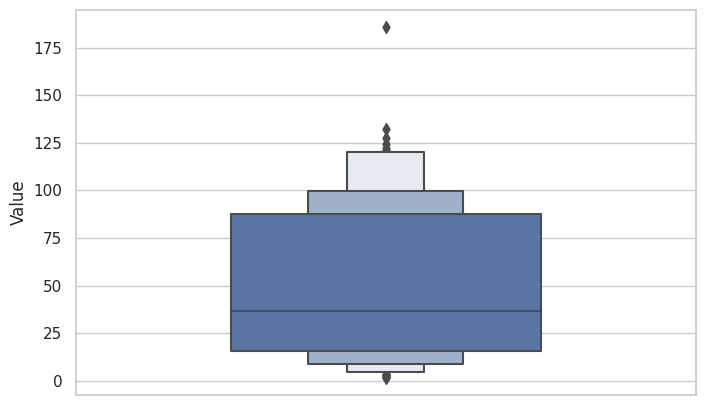

In [ ]:
plt.figure(figsize=(8,5))
sns.boxenplot(y='Value', data=player_list, width=0.5)
plt.show()

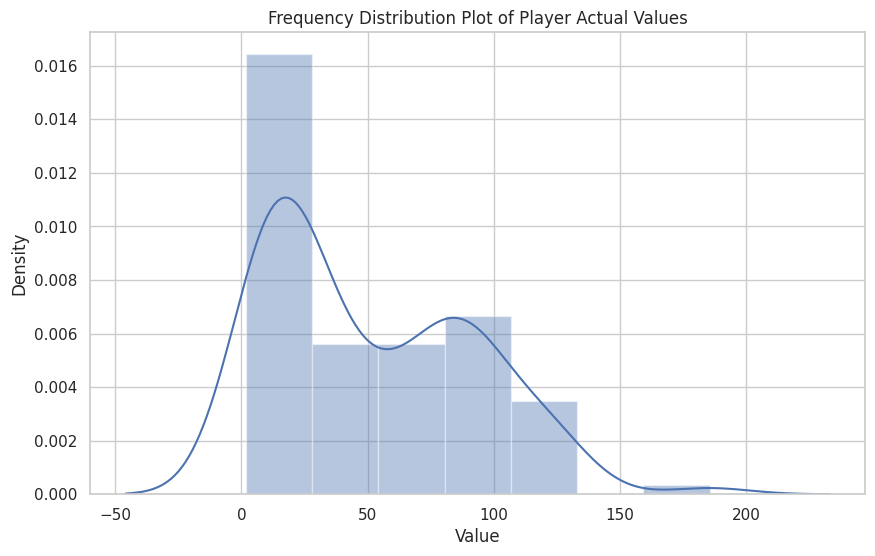

In [ ]:
x = player_list.Value
sns.set(style="whitegrid")
plt.figure(figsize=(10,6))
sns.distplot(x).set_title('Frequency Distribution Plot of Player Actual Values')
plt.show()

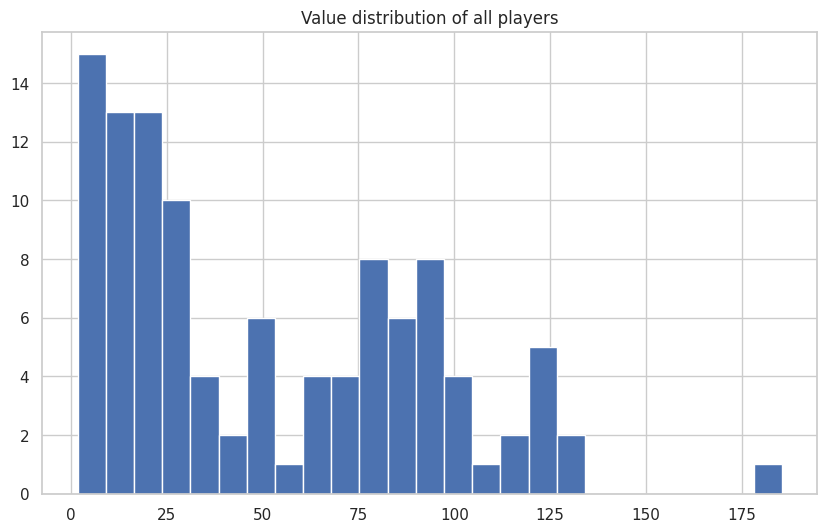

In [ ]:
plt.figure(1, figsize=(10, 6))
sns.set(style="whitegrid")
plt.hist( x= 'Value', bins=25,data=player_list)
plt.title('Value distribution of all players')
plt.show()

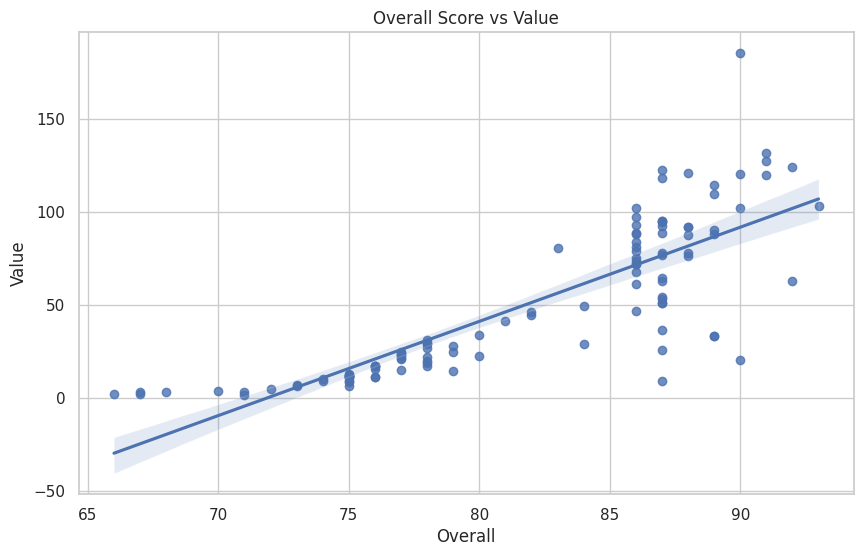

In [ ]:
plt.figure(figsize=(10,6))
sns.regplot(x="Overall",y="Value",data=player_list)
plt.title('Overall Score vs Value')
plt.show()

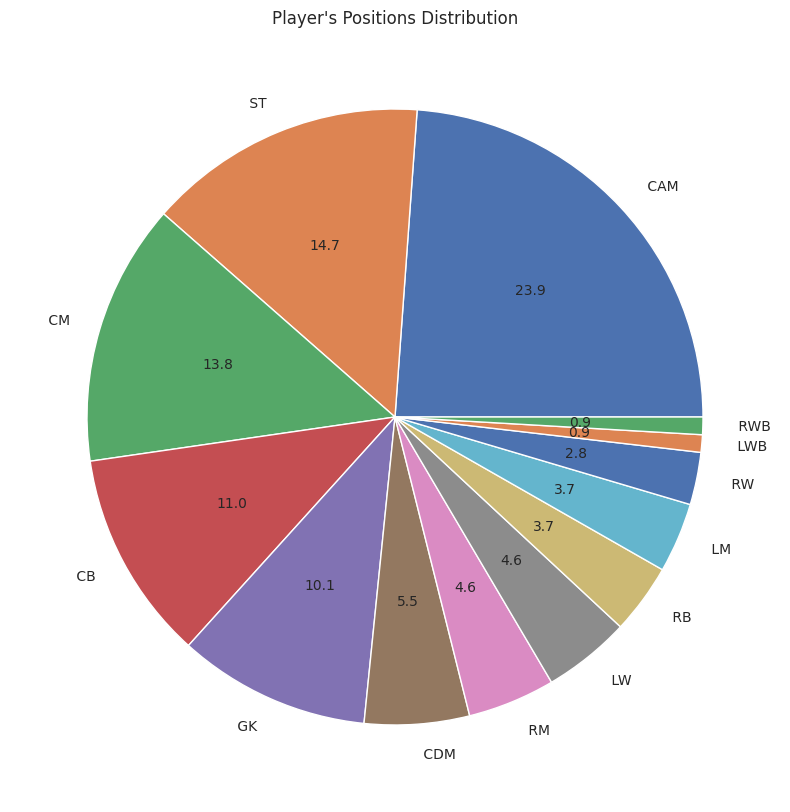

In [ ]:
plt.figure(figsize=(10,10))
loc=player_list.Position.value_counts()
loc.plot(kind='pie' ,autopct='%.1f',fontsize=10,subplots=True)
plt.title("Player's Positions Distribution")
plt.ylabel("")
plt.show()

<Figure size 2000x2000 with 0 Axes>

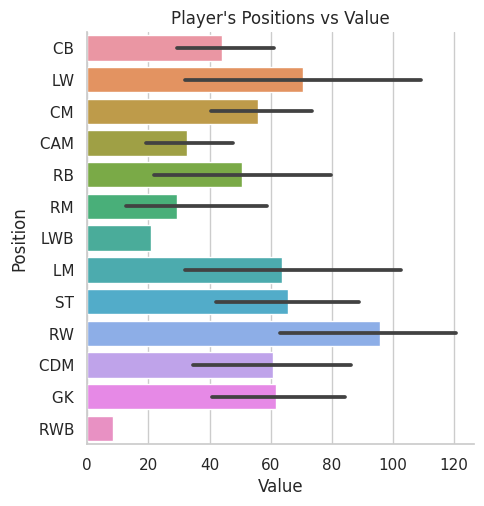

In [ ]:
plt.figure(figsize=(10,10),dpi=200)
graph = sns.catplot(y="Position", x="Value", kind="bar",  data=player_list)
plt.title("Player's Positions vs Value")
plt.show()

# Data Modelling

In [ ]:
#Changing columns order
player_list = player_list[['Name','Value','Age','Overall','Potential','Team','Height','Weight','Foot','Best_Overall',
                           'Position','Growth','Wage','Release_Clause','Attacking','Crossing','Finishing',
                           'Heading_Accuracy','Short_Passing','Volleys','Skill','Dribbling','Curve','FK_Accuracy',
                           'Long_Passing','Ball_Control','Movement','Acceleration','Sprint_Speed','Agility',
                           'Reactions','Balance','Power','Shot_Power','Jumping','Stamina','Strength','Long_Shots',
                           'Mentality','Aggression','Interceptions','Positioning','Vision','Penalties','Composure',
                           'Defending','Marking','Standing_Tackle','Sliding_Tackle','Goalkeeping','GK_Diving',
                           'GK_Handling','GK_Kicking','GK_Positioning','GK_Reflexes','Total_Stats','Base_Stats',
                           'Int_Reputation','PAC','SHO','PAS','DRI','DEF','PHY']]
player_list

,Name,Value,Age,Overall,Potential,Team,Height,Weight,Foot,Best_Overall,Position,Growth,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY
0,T. Tomiyasu,12.0,21,75,85,Bologna,188.0,84.0,Right,77,CB,10,0.019,24.0,261,62,29,69,71,30,290,68,48,37,66,71,350,71,68,70,71,70,291,42,69,75,77,28,283,73,76,38,59,37,60,231,77,77,77,45,9,14,6,5,11,1751,384,1,69,32,63,69,76,75
1,D. Rossi,17.0,22,76,84,Los Angeles FC,170.0,68.0,Right,77,LW,8,0.009,28.9,331,67,77,44,72,71,315,75,72,34,57,77,405,83,82,83,73,84,335,75,58,79,54,69,279,49,21,77,75,57,74,88,42,18,28,67,11,14,15,14,13,1820,388,2,82,74,67,77,29,59
2,E. Camavinga,29.0,17,78,89,Stade Rennais FC,183.0,68.0,Left,80,CM,11,0.006,60.9,336,70,62,64,81,59,369,80,72,59,77,81,379,74,72,79,78,76,358,72,68,79,75,64,365,77,76,73,77,62,81,229,75,78,76,50,12,6,8,12,12,2086,445,1,73,65,76,80,75,76
3,Junior Messias,1.8,29,71,71,Crotone,178.0,70.0,Left,71,CAM,0,0.009,3.2,320,65,69,52,74,60,361,78,71,73,66,73,346,75,69,66,68,68,301,68,53,64,52,64,279,44,41,66,66,62,60,87,28,33,26,52,8,8,15,9,12,1746,369,1,72,67,69,74,34,53
4,Emerson,27.0,21,78,85,Real Betis,180.0,79.0,Right,78,RB,7,0.017,62.1,323,75,57,70,77,44,332,72,73,47,65,75,376,79,79,74,75,69,370,77,78,79,74,62,334,80,72,73,61,48,65,227,70,78,79,56,11,13,9,10,13,2018,435,1,79,62,70,73,74,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,De Gea,46.5,29,86,86,Manchester United,193.0,82.0,Right,86,GK,0,0.150,88.4,112,17,13,21,48,13,139,18,21,19,43,38,305,57,58,63,84,43,234,57,67,43,55,12,170,38,30,12,61,29,65,59,25,21,13,413,88,80,76,80,89,1432,471,4,88,80,76,89,58,80
105,R. Lukaku,73.5,27,86,86,Inter,190.0,94.0,Left,86,ST,0,0.175,125.0,402,73,88,87,77,77,372,78,78,66,70,80,355,78,84,60,87,46,400,87,71,73,95,74,348,71,27,87,75,88,86,101,30,41,30,54,8,15,14,7,10,2032,437,3,81,84,74,76,38,84
106,A. Maitland-Niles,8.5,22,75,81,West Bromwich Albion,178.0,70.0,Right,77,RWB,6,0.049,0.0,296,69,58,50,75,44,322,78,64,36,68,76,387,79,83,79,75,71,344,72,55,82,69,66,356,69,73,72,73,69,76,220,71,77,72,54,15,9,7,10,13,1979,434,1,81,63,70,77,71,72
107,M. Kean,31.0,20,78,86,Paris Saint-Germain,183.0,72.0,Right,80,ST,8,0.062,0.0,339,42,81,76,68,72,304,80,67,43,38,76,392,83,84,74,73,78,372,84,75,70,83,60,286,57,25,81,58,65,69,105,40,35,30,47,13,8,10,7,9,1845,405,1,84,76,55,78,38,74


In [ ]:
#View the correlations
corr_mat = player_list.corr()
corr_mat

,Value,Age,Overall,Potential,Height,Weight,Best_Overall,Growth,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY
Value,1.000000,0.333659,0.827319,0.726972,0.034328,0.104854,0.833978,-0.528918,0.730091,0.989752,0.234473,0.177853,0.197029,0.094805,0.304946,0.284832,0.213870,0.088601,0.202954,0.226280,0.287603,0.187868,0.247581,0.064619,0.090572,0.132082,0.788307,0.095758,0.302248,0.335306,0.156582,0.197479,0.220755,0.145032,0.231664,0.110333,0.013655,0.205589,0.461966,0.200062,0.607975,-0.028868,-0.010609,-0.017691,-0.055249,0.094238,0.092790,0.096014,0.116892,0.090439,0.074482,0.351591,0.611286,0.596255,0.210798,0.425108,0.580907,0.521497,0.042752,0.326520
Age,0.333659,1.000000,0.713145,0.130089,0.105076,0.304181,0.672698,-0.876082,0.697858,0.307065,-0.043021,-0.062243,-0.085785,-0.029490,-0.007700,0.011746,-0.073278,-0.233761,-0.083670,0.039515,0.111451,-0.136861,-0.088850,-0.243524,-0.255448,-0.157946,0.680645,-0.148550,0.033927,0.136876,0.195632,-0.116561,0.138739,-0.099384,0.016835,-0.006173,-0.021754,-0.086430,0.132987,0.118978,0.436314,-0.088858,-0.046866,-0.109058,-0.102507,0.341940,0.342779,0.338389,0.346605,0.339216,0.331132,0.084642,0.521598,0.811765,0.054642,0.355284,0.424894,0.383567,0.103665,0.386855
Overall,0.827319,0.713145,1.000000,0.695757,0.133798,0.257888,0.990837,-0.794118,0.823991,0.811446,0.055409,0.036667,-0.011676,-0.005875,0.163809,0.107587,0.041085,-0.145180,0.026001,0.097975,0.281267,-0.018636,0.092820,-0.121573,-0.107823,-0.019238,0.932242,-0.047146,0.182037,0.251864,0.269106,0.039738,0.245596,-0.037052,0.123451,0.079228,0.049995,0.003790,0.348893,0.100553,0.671382,-0.004729,0.031675,-0.012955,-0.028869,0.328091,0.329171,0.326844,0.339876,0.328035,0.306509,0.263925,0.805200,0.820428,0.225777,0.457720,0.669634,0.593425,0.195006,0.520332
Potential,0.726972,0.130089,0.695757,1.000000,0.150942,0.096420,0.722389,-0.115971,0.505924,0.737764,0.003978,-0.014105,-0.030401,-0.040349,0.101423,0.040270,0.006776,-0.108783,-0.007887,0.009501,0.202629,-0.011240,0.116311,-0.021558,-0.010535,0.060990,0.620884,-0.016587,0.118927,0.122607,0.286768,0.020550,0.155613,-0.051926,0.024282,0.004348,0.006539,-0.033443,0.254557,-0.037054,0.443864,-0.023038,-0.020163,-0.013966,-0.033771,0.246352,0.243665,0.248971,0.248765,0.246970,0.235255,0.158400,0.584606,0.457170,0.272846,0.307038,0.475772,0.460835,0.119048,0.347932
Height,0.034328,0.105076,0.133798,0.150942,1.000000,0.800457,0.127661,-0.057301,-0.051210,0.013913,-0.459584,-0.599095,-0.473210,-0.050766,-0.460581,-0.430067,-0.523975,-0.572302,-0.538076,-0.419252,-0.285843,-0.520010,-0.714164,-0.639102,-0.443781,-0.720296,0.034337,-0.808430,-0.198199,-0.199684,0.271240,-0.420589,0.541087,-0.470144,-0.381310,-0.135655,-0.025547,-0.530619,-0.417970,-0.340418,-0.180560,-0.084791,-0.048736,-0.101632,-0.096665,0.446844,0.443225,0.452565,0.445353,0.443263,0.434298,-0.426740,0.135824,0.101625,-0.146252,-0.024739,-0.155984,-0.204398,0.181521,0.607545
Weight,0.104854,0.304181,0.257888,0.096420,0.800457,1.000000,0.230573,-0.275030,0.093098,0.081830,-0.400475,-0.544649,-0.430870,-0.027877,-0.398742,-0.350198,-0.473729,-0.523935,-0.495027,-0.357929,-0.274469,-0.465348,-0.608641,-0.565121,-0.358713,-0.679465,0.171485,-0.712374,-0.136481,-0.106202,0.271329,-0.418681,0.636546,-0.439869,-0.338276,-0.073047,-0.085390,-0.473768,-0.373772,-0.259553,-0.096012,-0.120008,-0.066923,-0.147745,-0.134735,0.414389,0.402156,0.419065,0.433967,0.411943,0.392765,-0.371462,0.138422,0.268492,-0.095261,-0.006490,-0.127355,-0.191612,0.112858,0.640701


In [ ]:
#Positive correlation With Value
pd.DataFrame(corr_mat["Value"]).sort_values("Value", ascending=False).head(10)

,Value
Value,1.000000
Release_Clause,0.989752
Best_Overall,0.833978
Overall,0.827319
Reactions,0.788307
Wage,0.730091
Potential,0.726972
Base_Stats,0.611286
Composure,0.607975
Int_Reputation,0.596255


In [ ]:
#Negative correlation With Value
pd.DataFrame(corr_mat["Value"]).sort_values("Value", ascending=True).head(4)

,Value
Growth,-0.528918
Sliding_Tackle,-0.055249
Defending,-0.028868
Standing_Tackle,-0.017691


In [ ]:
# Slice data into faeture and target

Xb= player_list.drop(columns=["Value","Name","Team","Foot","Position"])
yb= player_list.loc[:,"Value"]

In [ ]:
# fit model with target as player market value
player_modelb = sm.OLS(yb, Xb, data=player_list)

resultsb = player_modelb.fit()

print(resultsb.summary())

                                 OLS Regression Results                                
Dep. Variable:                  Value   R-squared (uncentered):                   0.997
Model:                            OLS   Adj. R-squared (uncentered):              0.995
Method:                 Least Squares   F-statistic:                              437.4
Date:                Wed, 06 Oct 2021   Prob (F-statistic):                    2.08e-62
Time:                        16:16:16   Log-Likelihood:                         -289.59
No. Observations:                 109   AIC:                                      677.2
Df Residuals:                      60   BIC:                                      809.1
Df Model:                          49                                                  
Covariance Type:            nonrobust                                                  
                       coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------

In [ ]:
#Fitting Simple Linear Regression
regressor = LinearRegression()
regressor.fit(Xb,yb)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
#Prediction on all data and calculate difference between tha actual value and predicted value
y_pred = regressor.predict(Xb)
df = pd.DataFrame({'Name':player_list.Name,'Actual': yb, 'Predicted': y_pred})
df["Difference"] = df["Actual"]-df["Predicted"]
df_under = round(df.sort_values('Difference').set_index('Name').head(10),2)
df_under

,Actual,Predicted,Difference
Name,,,
João Félix,80.5,88.52,-8.02
T. Kroos,87.5,95.21,-7.71
P. Pogba,72.0,78.18,-6.18
J. Koundé,44.5,50.51,-6.01
M. Mohamed,11.5,17.14,-5.64
Cucurella,41.5,45.95,-4.45
E. Haaland,122.5,126.85,-4.35
J. Vardy,51.0,55.29,-4.29
K. Coman,93.0,97.22,-4.22


In [ ]:
df_over = round(df.sort_values('Difference').set_index('Name').tail(10),2)
df_over

,Actual,Predicted,Difference
Name,,,
W. Szczęsny,53.0,49.08,3.92
Y. Demir,3.2,-0.74,3.94
R. Faivre,7.0,2.55,4.45
H. Dervişoğlu,2.3,-2.65,4.95
L. Goretzka,94.5,88.55,5.95
T. Müller,77.0,70.88,6.12
A. Laporte,79.0,71.65,7.35
A. Maitland-Niles,8.5,1.10,7.40
M. Verratti,72.0,63.42,8.58


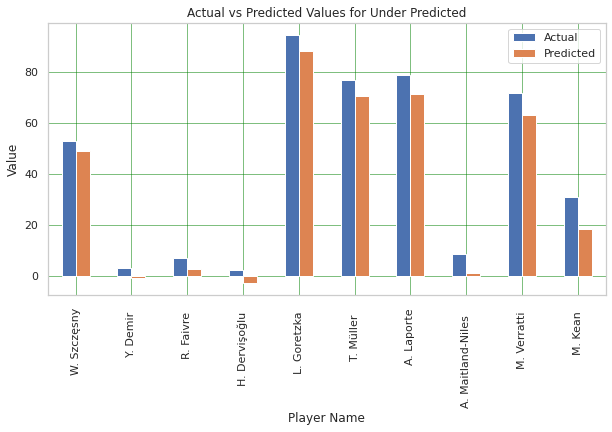

In [ ]:
#Plot the comparision of Actual and Predicted Values for Under Predicted
df_over[["Actual","Predicted"]].plot(kind='bar',figsize=(10,5))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title("Actual vs Predicted Values for Under Predicted")
plt.xlabel("Player Name")
plt.ylabel('Value')
plt.show()

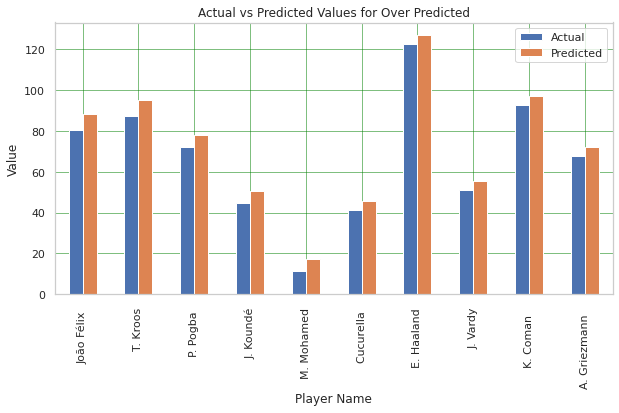

In [ ]:
#Plot the comparision of Actual and Predicted Values for Over Predicted

df_under[["Actual","Predicted"]].plot(kind='bar',figsize=(10,5))
plt.grid(which='major', linestyle='-', linewidth='0.5', color='green')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.title("Actual vs Predicted Values for Over Predicted")
plt.xlabel("Player Name")
plt.ylabel('Value')
plt.show()

In [ ]:
#Calculating MAE, MSE, RMSE and R^2 values of our model
print('Mean Absolute Error:', metrics.mean_absolute_error(yb, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(yb, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(yb, y_pred)))
print('Linear Regression R^2:',regressor.score(Xb,yb))

Mean Absolute Error: 2.540803832095764
Mean Squared Error: 11.056483204533796
Root Mean Squared Error: 3.3251290508089753
Linear Regression R^2: 0.9932442957998987


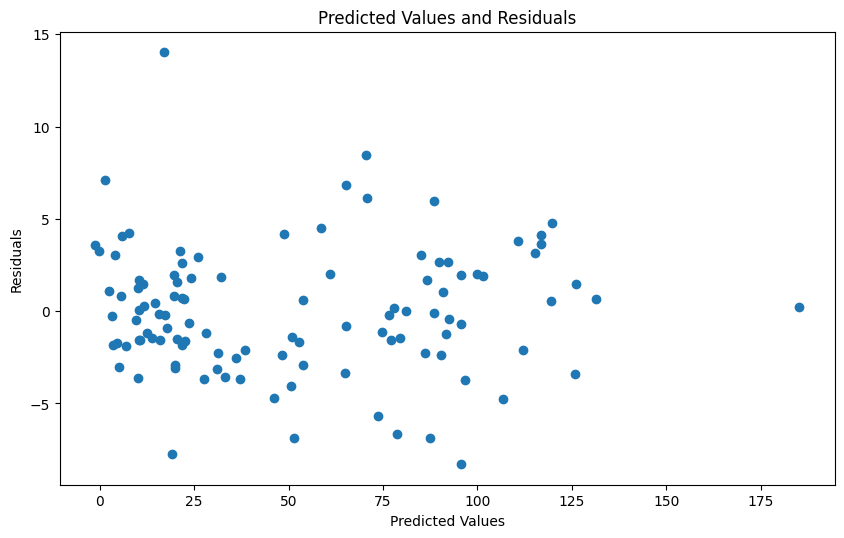

In [ ]:
#Plotting Residuals
plt.figure(figsize=(10,6),dpi=100),
plt.style.use('default')
plt.scatter(resultsb.predict(), resultsb.resid);
plt.title("Predicted Values and Residuals")
plt.ylabel("Residuals")
plt.xlabel("Predicted Values")
plt.show()

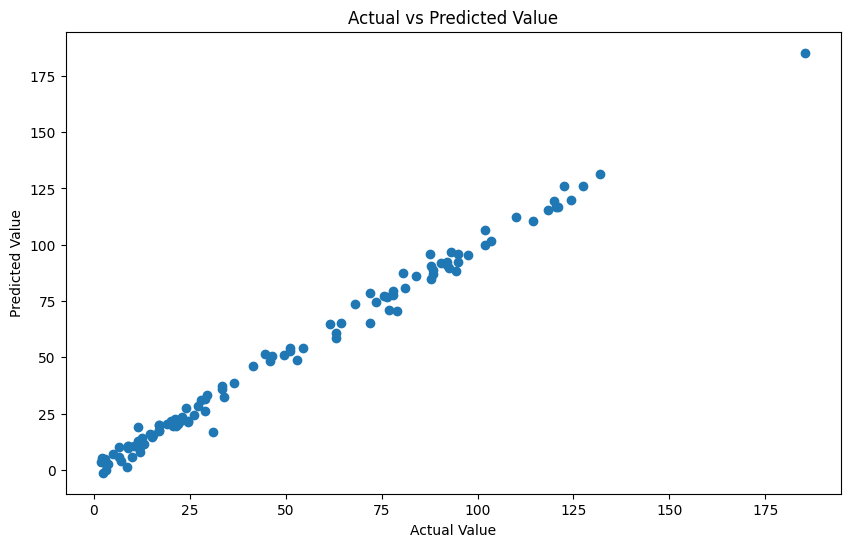

In [ ]:
# Actual Values vs Predicted Values
plt.figure(figsize=(10,6),dpi=100),
plt.style.use('default')
plt.scatter(yb, resultsb.predict(Xb))
plt.title ("Actual vs Predicted Value")
plt.ylabel("Predicted Value")
plt.xlabel("Actual Value")
plt.show()

In [ ]:
#Analysis on most selected columns

X1= player_list.loc[:,['Overall','Age','Int_Reputation','Growth','Release_Clause']]
y1= player_list.loc[:,"Value"]

player_model1 = sm.OLS(y1, X1, data=player_list)

results1 = player_model1.fit()

print(results1.summary());

                                 OLS Regression Results                                
Dep. Variable:                  Value   R-squared (uncentered):                   0.994
Model:                            OLS   Adj. R-squared (uncentered):              0.993
Method:                 Least Squares   F-statistic:                              3227.
Date:                Wed, 06 Oct 2021   Prob (F-statistic):                   2.50e-112
Time:                        16:16:18   Log-Likelihood:                         -334.85
No. Observations:                 109   AIC:                                      679.7
Df Residuals:                     104   BIC:                                      693.2
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------

In [ ]:
#Correlation matrics of selected features
player_list_selected_features= player_list[['Value','Overall','Age','Int_Reputation','Growth','Release_Clause','Height','Weight']]

player_list_selected_features.corr()

,Value,Overall,Age,Int_Reputation,Growth,Release_Clause,Height,Weight
Value,1.000000,0.827319,0.333659,0.596255,-0.528918,0.989752,0.034328,0.104854
Overall,0.827319,1.000000,0.713145,0.820428,-0.794118,0.811446,0.133798,0.257888
Age,0.333659,0.713145,1.000000,0.811765,-0.876082,0.307065,0.105076,0.304181
Int_Reputation,0.596255,0.820428,0.811765,1.000000,-0.747680,0.564836,0.101625,0.268492
Growth,-0.528918,-0.794118,-0.876082,-0.747680,1.000000,-0.497836,-0.057301,-0.275030
Release_Clause,0.989752,0.811446,0.307065,0.564836,-0.497836,1.000000,0.013913,0.081830
Height,0.034328,0.133798,0.105076,0.101625,-0.057301,0.013913,1.000000,0.800457
Weight,0.104854,0.257888,0.304181,0.268492,-0.275030,0.081830,0.800457,1.000000


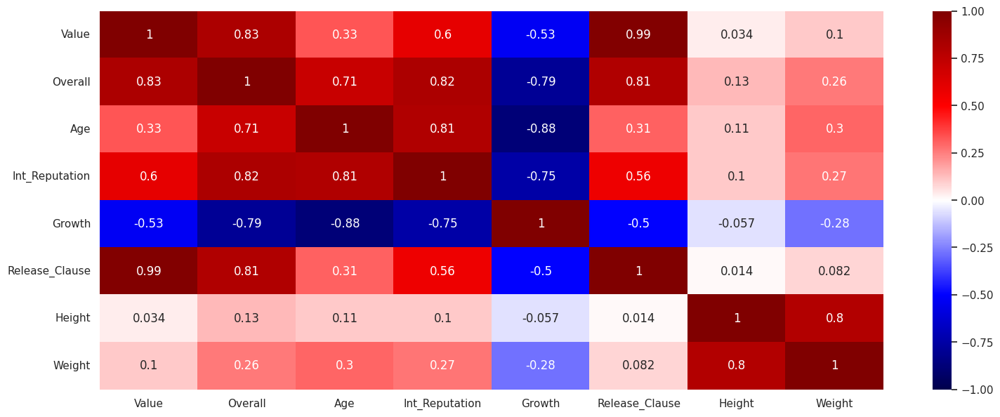

In [ ]:
#Heatmap of correlation values
plt.figure(1, figsize=(18, 7))
sns.set(style="whitegrid")
sns.heatmap(player_list_selected_features.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1)
plt.yticks(rotation=0);
plt.show()

<Figure size 1800x700 with 0 Axes>

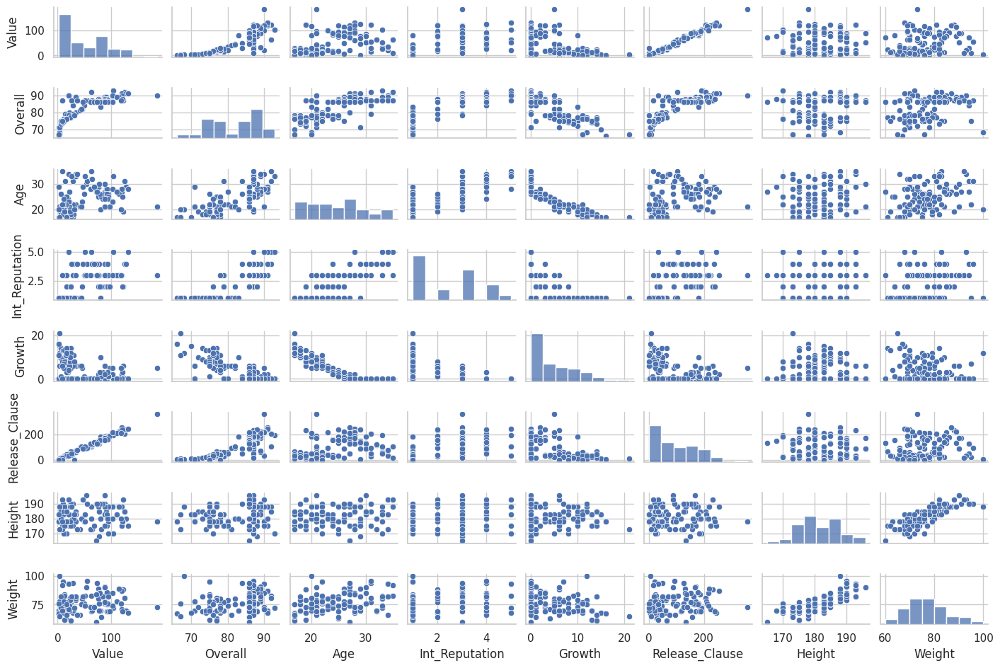

In [ ]:
#Pairplot of selected features
plt.figure(1, figsize=(18, 7))
sns.set(style="whitegrid")
g=sns.pairplot(player_list_selected_features, height=1.2, aspect=1.5)
plt.yticks(rotation=90);
plt.show()

In [ ]:
#Split data into train, test and validation (%60 - %20)

X_train, X_test, y_train, y_test = train_test_split(X1,y1,test_size=0.2, random_state=10)

X_train, X_val, y_train, y_val = train_test_split(X1,y1, test_size=.25, random_state=10)

lr = LinearRegression()
lr.fit(X_train,y_train)
pred = lr.predict(X_val)
mse = np.mean((pred-y_val)**2)

print(lr.score(X_test,y_test))
print(mse)
print(lr.coef_)

0.9845513841472106
52.081744952474594
[-0.04218183 -0.33591595  2.06476643 -0.37335293  0.50115617]


In [ ]:
coeff = pd.DataFrame(X_train.columns)

coeff['CoefficientEstimate'] = lr.coef_

coeff.sort_values("CoefficientEstimate")

,0,CoefficientEstimate
3,Growth,-0.373353
1,Age,-0.335916
0,Overall,-0.042182
4,Release_Clause,0.501156
2,Int_Reputation,2.064766


In [ ]:
model= sm.OLS(y1, X1, data=player_list_selected_features)

results = model.fit()

print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:                  Value   R-squared (uncentered):                   0.994
Model:                            OLS   Adj. R-squared (uncentered):              0.993
Method:                 Least Squares   F-statistic:                              3227.
Date:                Wed, 06 Oct 2021   Prob (F-statistic):                   2.50e-112
Time:                        16:16:52   Log-Likelihood:                         -334.85
No. Observations:                 109   AIC:                                      679.7
Df Residuals:                     104   BIC:                                      693.2
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------

In [ ]:
# Dummy Variables for Position
X2 = pd.concat([player_list.drop('Position', axis=1), pd.get_dummies(player_list['Position'])],axis=1)

X2 = X2.drop(columns=["Value","Name","Team","Foot"])

y2 = yb= player_list.loc[:,"Value"]


In [ ]:
# fit model with target as player market value
player_model2 = sm.OLS(y2, X2, data=player_list)

results2 = player_model2.fit()

print(results2.summary())

                            OLS Regression Results                            
Dep. Variable:                  Value   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.987
Method:                 Least Squares   F-statistic:                     134.1
Date:                Wed, 06 Oct 2021   Prob (F-statistic):           1.16e-38
Time:                        16:16:52   Log-Likelihood:                -276.50
No. Observations:                 109   AIC:                             677.0
Df Residuals:                      47   BIC:                             843.9
Df Model:                          61                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Age                 -1.2306      0.489  

In [ ]:
# Dummy Variables for Team

Xs = pd.concat([player_list.drop('Team', axis=1), pd.get_dummies(player_list['Team'])],axis=1)

Xs = Xs.drop(columns=["Value","Name","Position","Foot"])

ys = yb= player_list.loc[:,"Value"]

In [ ]:
# fit model with target as player market value
player_model3 = sm.OLS(ys, Xs, data=player_list)

results3 = player_model3.fit()

print(results3.summary())

                            OLS Regression Results                            
Dep. Variable:                  Value   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.994
Method:                 Least Squares   F-statistic:                     173.0
Date:                Wed, 06 Oct 2021   Prob (F-statistic):           9.08e-07
Time:                        16:16:52   Log-Likelihood:                -122.70
No. Observations:                 109   AIC:                             451.4
Df Residuals:                       6   BIC:                             728.6
Df Model:                         102                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Age                 

# Regression Assumptions

## Assumption 1: regression is linear in parameters and correctly specified



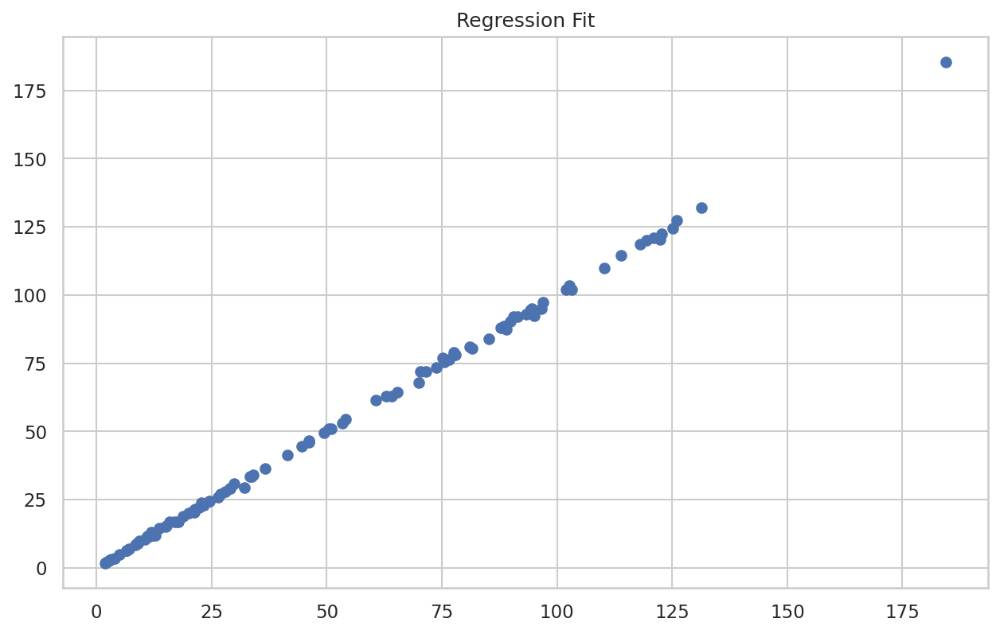

In [ ]:
# Regression Fit
plt.figure(figsize=(10,6),dpi=150),
lr = LinearRegression()
fit = lr.fit(Xs,ys);
pred = lr.predict(Xs)
plt.scatter(pred,ys)
plt.title("Regression Fit")
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


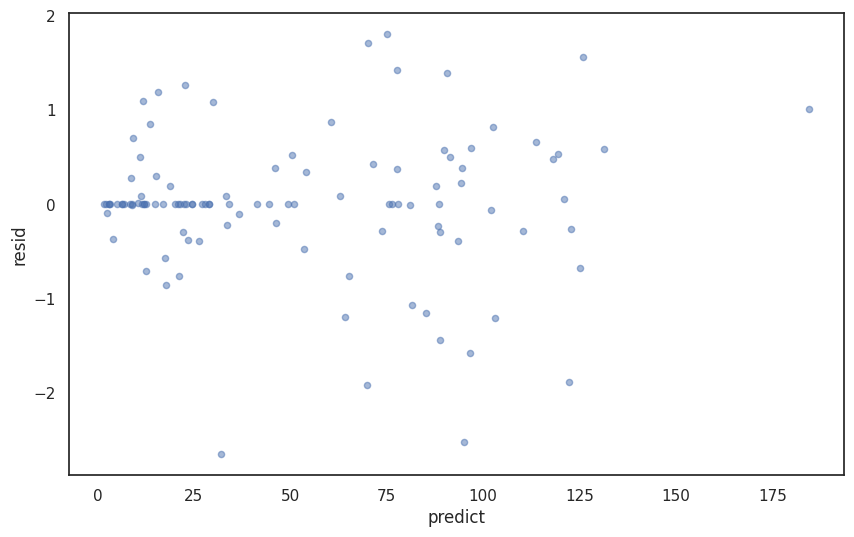

In [ ]:
df['predict']=(lr.predict(Xs))
df['resid']= (ys-df.predict)
with sns.axes_style('white'):
    plot = df.plot(
        kind='scatter', x='predict', y='resid', alpha=0.5, figsize=(10,6))

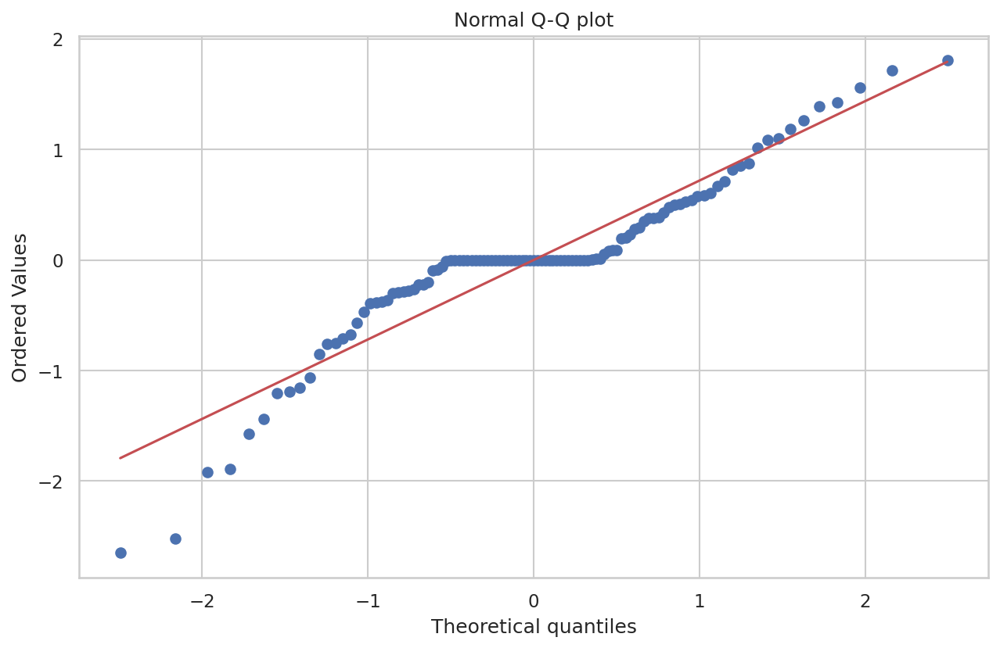

In [ ]:
# Normal Q-Q Plot
plt.figure(figsize=(10,6),dpi=150),
stats.probplot(df['resid'], dist="norm", plot=plt)
plt.title("Normal Q-Q plot")
plt.show()

## Assumption 2: residuals should be normally distributed with zero mean

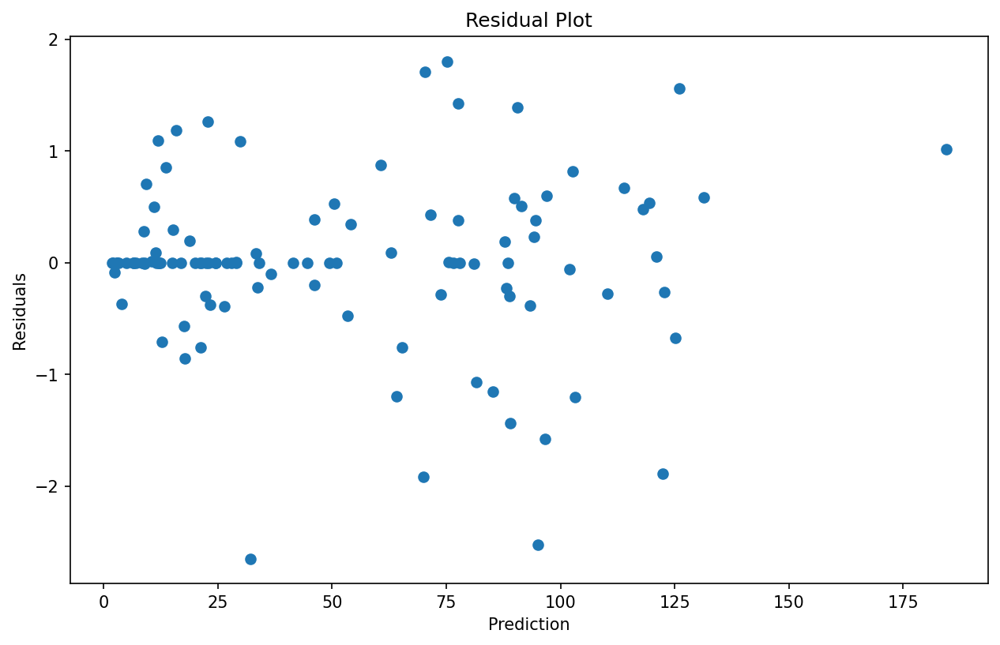

In [ ]:
# Plot your predicted values on the x-axis, and your residuals on the y-axis

player_model = sm.OLS(ys, Xs, data=player_list)

resultsl = player_model.fit()

plt.figure(figsize=(10,6),dpi=150),
plt.style.use('default')
plt.scatter(resultsl.predict(), resultsl.resid);
plt.title("Residual Plot")
plt.ylabel("Residuals")
plt.xlabel("Prediction")
plt.show()

## Assumption 3: Homoscedasticity test for residuals

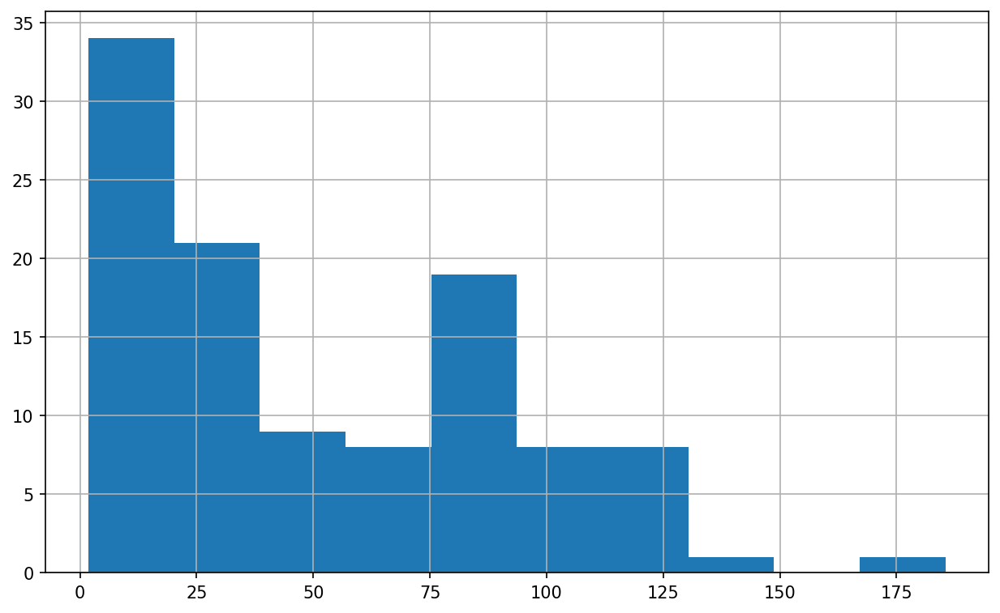

In [ ]:
# create histogram
plt.figure(figsize=(10,6),dpi=150),

y1.hist();

# note the positive skew

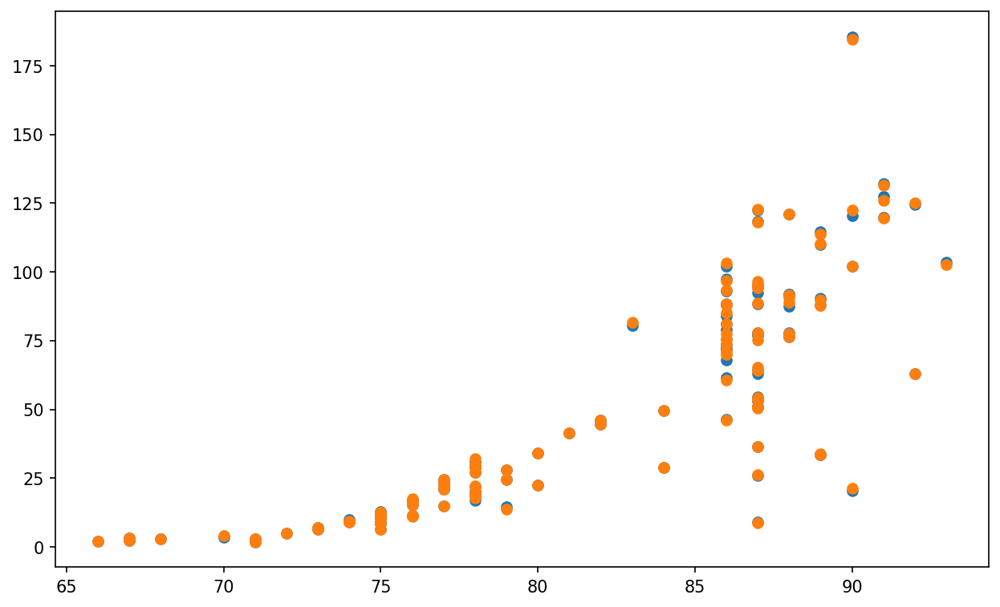

In [ ]:
# quick reg plot
plt.figure(figsize=(10,6),dpi=150),


plt.scatter(X1.Overall,y1)
plt.scatter(X1.Overall,df.predict);

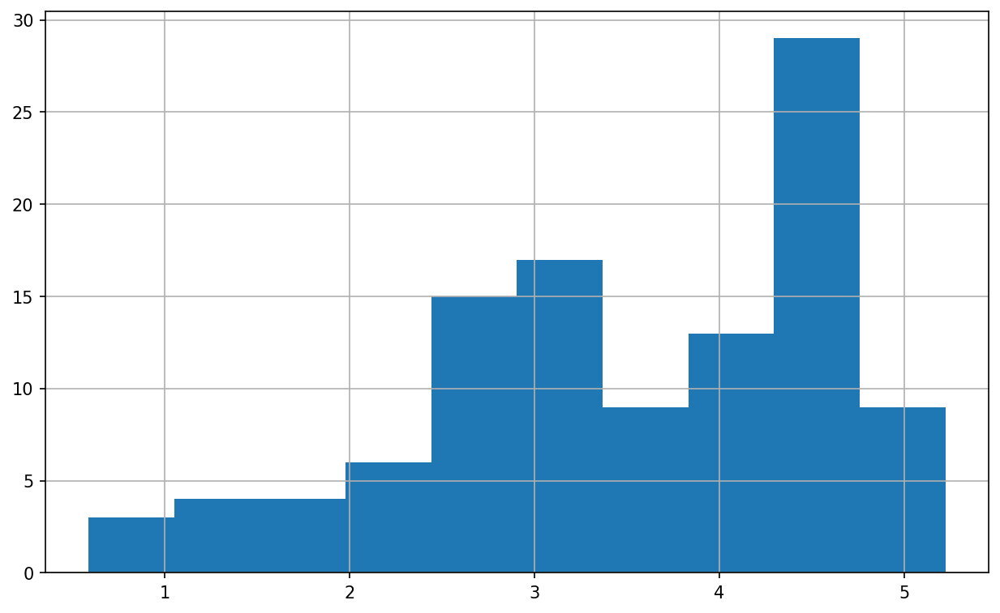

In [ ]:
plt.figure(figsize=(10,6),dpi=150),


np.log(y1).hist();

In [ ]:
#set up the model with log value

X1= player_list.loc[:,['Overall','Age','Weight','Height','Growth','Release_Clause',]]
y1= player_list.loc[:,"Value"]

yl = np.log1p(y1)

player_model1 = sm.OLS(yl, X1, data=player_list)

results1 = player_model1.fit()

results1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Value   R-squared (uncentered):                   0.995
Model:                            OLS   Adj. R-squared (uncentered):              0.995
Method:                 Least Squares   F-statistic:                              3510.
Date:                Wed, 06 Oct 2021   Prob (F-statistic):                   1.08e-116
Time:                        16:16:56   Log-Likelihood:                         -6.6092
No. Observations:                 109   AIC:                                      25.22
Df Residuals:                     103   BIC:                                      41.37
Df Model:                           6                                                  
Covariance Type:            nonrobust                                                  
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Overall            0.1269      0.011     11.969      0.000       0.106       0.148
Age               -0.0984      0.013     -7.475      0.000      -0.125      -0.072
Weight             0.0130      0.005      2.682      0.009       0.003       0.023
Height            -0.0304      0.005     -5.852      0.000      -0.041      -0.020
Growth            -0.0511      0.013     -4.035      0.000      -0.076      -0.026
Release_Clause     0.0034      0.001      4.822      0.000       0.002       0.005
==============================================================================
Omnibus:                        4.877   Durbin-Watson:                   1.893
Prob(Omnibus):                  0.087   Jarque-Bera (JB):                4.377
Skew:                          -0.479   Prob(JB):                        0.112
Kurtosis:                       3.216   Cond. No.                         162.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
#what coefficients our regression model has chosen
regressor = LinearRegression()
regressor.fit(X1,yl)
coeff_df = pd.DataFrame(regressor.coef_, X1.columns, columns=['Coefficient'])
coeff_df.sort_values("Coefficient",ascending=False)

,Coefficient
Overall,0.159254
Release_Clause,0.001866
Weight,-0.000604
Height,-0.007309
Growth,-0.034975
Age,-0.101486


In [ ]:
#Prediction on all data and calculate difference between tha actual value and predicted value
#ye=np.exp(yl)
y_pred = regressor.predict(X1)
df = pd.DataFrame({'Name':player_list.Name,'Actual': yl, 'Predicted': (y_pred)})
df['Actual_n'] = np.expm1(df['Actual'])
df['Predicted_n'] = np.expm1(df['Predicted'])

#df_under = round(df.sort_values('Difference_n').set_index('Name').head(10),2)
#df_over = round(df.sort_values('Difference_n').set_index('Name').tail(10),2)
df

,Name,Actual,Predicted,Actual_n,Predicted_n
0,T. Tomiyasu,2.564949,2.420376,12.0,10.250090
1,D. Rossi,2.890372,2.698461,17.0,13.856856
2,E. Camavinga,3.401197,3.384154,29.0,28.493043
3,Junior Messias,1.029619,1.363964,1.8,2.911667
4,Emerson,3.332205,3.135640,27.0,22.003353
...,...,...,...,...,...
104,De Gea,3.860730,3.794847,46.5,43.471452
105,R. Lukaku,4.310799,4.080790,73.5,58.192237
106,A. Maitland-Niles,2.251292,2.495556,8.5,11.128473
107,M. Kean,3.465736,3.068584,31.0,20.511416


## Assumption 4: Detecting correlation between residuals and observations


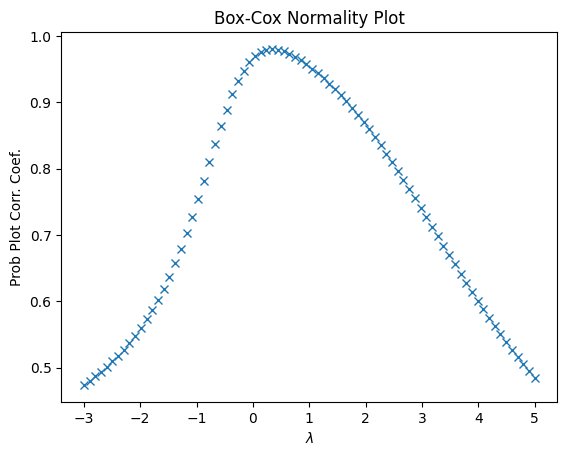

In [ ]:
# plot to show optimal lambda values
fig = plt.figure()
ax = fig.add_subplot(111)
prob = stats.boxcox_normplot(player_list.Value, -3, 5, plot=ax)

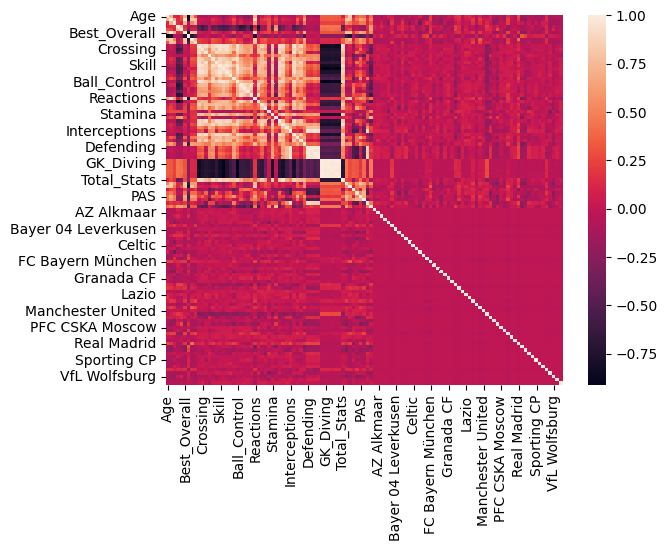

In [ ]:
sns.heatmap(Xs.corr())

## Assumption 5: multicollinearity test according to Condition Number


In [ ]:
player_list

,Name,Value,Age,Overall,Potential,Team,Height,Weight,Foot,Best_Overall,Position,Growth,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY
0,T. Tomiyasu,12.0,21,75,85,Bologna,188.0,84.0,Right,77,CB,10,0.019,24.0,261,62,29,69,71,30,290,68,48,37,66,71,350,71,68,70,71,70,291,42,69,75,77,28,283,73,76,38,59,37,60,231,77,77,77,45,9,14,6,5,11,1751,384,1,69,32,63,69,76,75
1,D. Rossi,17.0,22,76,84,Los Angeles FC,170.0,68.0,Right,77,LW,8,0.009,28.9,331,67,77,44,72,71,315,75,72,34,57,77,405,83,82,83,73,84,335,75,58,79,54,69,279,49,21,77,75,57,74,88,42,18,28,67,11,14,15,14,13,1820,388,2,82,74,67,77,29,59
2,E. Camavinga,29.0,17,78,89,Stade Rennais FC,183.0,68.0,Left,80,CM,11,0.006,60.9,336,70,62,64,81,59,369,80,72,59,77,81,379,74,72,79,78,76,358,72,68,79,75,64,365,77,76,73,77,62,81,229,75,78,76,50,12,6,8,12,12,2086,445,1,73,65,76,80,75,76
3,Junior Messias,1.8,29,71,71,Crotone,178.0,70.0,Left,71,CAM,0,0.009,3.2,320,65,69,52,74,60,361,78,71,73,66,73,346,75,69,66,68,68,301,68,53,64,52,64,279,44,41,66,66,62,60,87,28,33,26,52,8,8,15,9,12,1746,369,1,72,67,69,74,34,53
4,Emerson,27.0,21,78,85,Real Betis,180.0,79.0,Right,78,RB,7,0.017,62.1,323,75,57,70,77,44,332,72,73,47,65,75,376,79,79,74,75,69,370,77,78,79,74,62,334,80,72,73,61,48,65,227,70,78,79,56,11,13,9,10,13,2018,435,1,79,62,70,73,74,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,De Gea,46.5,29,86,86,Manchester United,193.0,82.0,Right,86,GK,0,0.150,88.4,112,17,13,21,48,13,139,18,21,19,43,38,305,57,58,63,84,43,234,57,67,43,55,12,170,38,30,12,61,29,65,59,25,21,13,413,88,80,76,80,89,1432,471,4,88,80,76,89,58,80
105,R. Lukaku,73.5,27,86,86,Inter,190.0,94.0,Left,86,ST,0,0.175,125.0,402,73,88,87,77,77,372,78,78,66,70,80,355,78,84,60,87,46,400,87,71,73,95,74,348,71,27,87,75,88,86,101,30,41,30,54,8,15,14,7,10,2032,437,3,81,84,74,76,38,84
106,A. Maitland-Niles,8.5,22,75,81,West Bromwich Albion,178.0,70.0,Right,77,RWB,6,0.049,0.0,296,69,58,50,75,44,322,78,64,36,68,76,387,79,83,79,75,71,344,72,55,82,69,66,356,69,73,72,73,69,76,220,71,77,72,54,15,9,7,10,13,1979,434,1,81,63,70,77,71,72
107,M. Kean,31.0,20,78,86,Paris Saint-Germain,183.0,72.0,Right,80,ST,8,0.062,0.0,339,42,81,76,68,72,304,80,67,43,38,76,392,83,84,74,73,78,372,84,75,70,83,60,286,57,25,81,58,65,69,105,40,35,30,47,13,8,10,7,9,1845,405,1,84,76,55,78,38,74


In [ ]:
#set up the model with log value

Xs= player_list.drop(columns=["Value","Name","Team","Foot","Position"])#.loc[:,['Overall','Age','Weight','Height','Growth','Release_Clause']]
ys= player_list.loc[:,"Value"]

player_model = sm.OLS(ys, Xs, data=player_list)

results = player_model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Value   R-squared (uncentered):                   0.997
Model:                            OLS   Adj. R-squared (uncentered):              0.995
Method:                 Least Squares   F-statistic:                              437.4
Date:                Wed, 06 Oct 2021   Prob (F-statistic):                    2.08e-62
Time:                        16:16:57   Log-Likelihood:                         -289.59
No. Observations:                 109   AIC:                                      677.2
Df Residuals:                      60   BIC:                                      809.1
Df Model:                          49                                                  
Covariance Type:            nonrobust                                                  
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Age                 -0.8927      0.377     -2.368      0.021      -1.647      -0.139
Overall              1.6945      0.588      2.883      0.005       0.519       2.870
Potential            0.5963      0.340      1.756      0.084      -0.083       1.276
Height              -0.0947      0.145     -0.653      0.517      -0.385       0.196
Weight              -0.1267      0.144     -0.881      0.382      -0.414       0.161
Best_Overall        -0.8960      0.847     -1.058      0.294      -2.590       0.798
Growth              -1.0982      0.315     -3.481      0.001      -1.729      -0.467
Wage                -8.9472     13.556     -0.660      0.512     -36.063      18.168
Release_Clause       0.4488      0.020     22.352      0.000       0.409       0.489
Attacking           -0.0158      0.088     -0.180      0.858      -0.192       0.160
Crossing            -0.3034      0.164     -1.847      0.070      -0.632       0.025
Finishing            0.0348      0.258      0.135      0.893      -0.481       0.551
Heading_Accuracy     0.1666      0.145      1.150      0.255      -0.123       0.456
Short_Passing       -0.1532      0.229     -0.669      0.506      -0.611       0.305
Volleys              0.2393      0.110      2.170      0.034       0.019       0.460
Skill               -0.1176      0.088     -1.335      0.187      -0.294       0.059
Dribbling            0.0501      0.252      0.198      0.843      -0.455       0.555
Curve                0.0239      0.128      0.187      0.852      -0.232       0.280
FK_Accuracy          0.0903      0.095      0.950      0.346      -0.100       0.281
Long_Passing        -0.1507      0.136     -1.110      0.271      -0.422       0.121
Ball_Control        -0.1312      0.275     -0.476      0.636      -0.682       0.420
Movement             0.0446      0.095      0.472      0.639      -0.145       0.234
Acceleration         0.4684      0.242      1.934      0.058      -0.016       0.953
Sprint_Speed         0.4242      0.316      1.344      0.184      -0.207       1.056
Agility             -0.1668      0.209     -0.799      0.428      -0.584       0.251
Reactions           -0.4607      0.260     -1.771      0.082      -0.981       0.060
Balance             -0.2205      0.162     -1.365      0.177      -0.544       0.103
Power               -0.0232      0.103     -0.226      0.822      -0.229       0.183
Shot_Power          -0.0707      0.249     -0.284      0.777      -0.569       0.427
Jumping             -0.0292      0.098     -0.299      0.766      -0.224       0.166
Stamina              0.0612      0.145      0.422      0.675      -0.229       0.351
Strength            -0.0046      0.316     -0.015      0.988      -0.636       0.627
Long_Shot

# Heatmap-Correlation

In [ ]:
player_list_selected_features= player_list#[['Value','Overall','Age','Int_Reputation','Growth','Release_Clause','Height','Weight']]

player_list_selected_features.corr()

,Value,Age,Overall,Potential,Height,Weight,Best_Overall,Growth,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing_Tackle,Sliding_Tackle,Goalkeeping,GK_Diving,GK_Handling,GK_Kicking,GK_Positioning,GK_Reflexes,Total_Stats,Base_Stats,Int_Reputation,PAC,SHO,PAS,DRI,DEF,PHY
Value,1.000000,0.333659,0.827319,0.726972,0.034328,0.104854,0.833978,-0.528918,0.730091,0.989752,0.234473,0.177853,0.197029,0.094805,0.304946,0.284832,0.213870,0.088601,0.202954,0.226280,0.287603,0.187868,0.247581,0.064619,0.090572,0.132082,0.788307,0.095758,0.302248,0.335306,0.156582,0.197479,0.220755,0.145032,0.231664,0.110333,0.013655,0.205589,0.461966,0.200062,0.607975,-0.028868,-0.010609,-0.017691,-0.055249,0.094238,0.092790,0.096014,0.116892,0.090439,0.074482,0.351591,0.611286,0.596255,0.210798,0.425108,0.580907,0.521497,0.042752,0.326520
Age,0.333659,1.000000,0.713145,0.130089,0.105076,0.304181,0.672698,-0.876082,0.697858,0.307065,-0.043021,-0.062243,-0.085785,-0.029490,-0.007700,0.011746,-0.073278,-0.233761,-0.083670,0.039515,0.111451,-0.136861,-0.088850,-0.243524,-0.255448,-0.157946,0.680645,-0.148550,0.033927,0.136876,0.195632,-0.116561,0.138739,-0.099384,0.016835,-0.006173,-0.021754,-0.086430,0.132987,0.118978,0.436314,-0.088858,-0.046866,-0.109058,-0.102507,0.341940,0.342779,0.338389,0.346605,0.339216,0.331132,0.084642,0.521598,0.811765,0.054642,0.355284,0.424894,0.383567,0.103665,0.386855
Overall,0.827319,0.713145,1.000000,0.695757,0.133798,0.257888,0.990837,-0.794118,0.823991,0.811446,0.055409,0.036667,-0.011676,-0.005875,0.163809,0.107587,0.041085,-0.145180,0.026001,0.097975,0.281267,-0.018636,0.092820,-0.121573,-0.107823,-0.019238,0.932242,-0.047146,0.182037,0.251864,0.269106,0.039738,0.245596,-0.037052,0.123451,0.079228,0.049995,0.003790,0.348893,0.100553,0.671382,-0.004729,0.031675,-0.012955,-0.028869,0.328091,0.329171,0.326844,0.339876,0.328035,0.306509,0.263925,0.805200,0.820428,0.225777,0.457720,0.669634,0.593425,0.195006,0.520332
Potential,0.726972,0.130089,0.695757,1.000000,0.150942,0.096420,0.722389,-0.115971,0.505924,0.737764,0.003978,-0.014105,-0.030401,-0.040349,0.101423,0.040270,0.006776,-0.108783,-0.007887,0.009501,0.202629,-0.011240,0.116311,-0.021558,-0.010535,0.060990,0.620884,-0.016587,0.118927,0.122607,0.286768,0.020550,0.155613,-0.051926,0.024282,0.004348,0.006539,-0.033443,0.254557,-0.037054,0.443864,-0.023038,-0.020163,-0.013966,-0.033771,0.246352,0.243665,0.248971,0.248765,0.246970,0.235255,0.158400,0.584606,0.457170,0.272846,0.307038,0.475772,0.460835,0.119048,0.347932
Height,0.034328,0.105076,0.133798,0.150942,1.000000,0.800457,0.127661,-0.057301,-0.051210,0.013913,-0.459584,-0.599095,-0.473210,-0.050766,-0.460581,-0.430067,-0.523975,-0.572302,-0.538076,-0.419252,-0.285843,-0.520010,-0.714164,-0.639102,-0.443781,-0.720296,0.034337,-0.808430,-0.198199,-0.199684,0.271240,-0.420589,0.541087,-0.470144,-0.381310,-0.135655,-0.025547,-0.530619,-0.417970,-0.340418,-0.180560,-0.084791,-0.048736,-0.101632,-0.096665,0.446844,0.443225,0.452565,0.445353,0.443263,0.434298,-0.426740,0.135824,0.101625,-0.146252,-0.024739,-0.155984,-0.204398,0.181521,0.607545
Weight,0.104854,0.304181,0.257888,0.096420,0.800457,1.000000,0.230573,-0.275030,0.093098,0.081830,-0.400475,-0.544649,-0.430870,-0.027877,-0.398742,-0.350198,-0.473729,-0.523935,-0.495027,-0.357929,-0.274469,-0.465348,-0.608641,-0.565121,-0.358713,-0.679465,0.171485,-0.712374,-0.136481,-0.106202,0.271329,-0.418681,0.636546,-0.439869,-0.338276,-0.073047,-0.085390,-0.473768,-0.373772,-0.259553,-0.096012,-0.120008,-0.066923,-0.147745,-0.134735,0.414389,0.402156,0.419065,0.433967,0.411943,0.392765,-0.371462,0.138422,0.268492,-0.095261,-0.006490,-0.127355,-0.191612,0.112858,0.640701


In [ ]:
player_list = pd.get_dummies(player_list, columns=["Team"])
player_list = pd.get_dummies(player_list, columns=["Position"])

# Final Model

In [ ]:
def ann_model(num_features):

  model = Sequential()
  model.add(Dense(num_features, input_dim=num_features, kernel_initializer='normal', activation='linear'))
  model.add(Dense(512, activation='linear'))
  model.add(Dense(512, activation='linear'))
  model.add(Dense(1024, activation='linear'))
  model.add(Dense(1024, activation='linear'))
  model.add(Dense(1, activation='linear'))
  #model.summary()

  model.compile(loss='mae', optimizer='adam', metrics=['mse','mae'])

  return model

In [ ]:

X1= player_list.drop(columns=["Value","Name","Foot"])#.loc[:,['Overall','Age','Weight','Height','Growth','Release_Clause',]]
y1= player_list.loc[:,"Value"]

yl = np.log1p(y1)

X_train, X_test, y_train, y_test = train_test_split(X1,yl,test_size=0.2, random_state=10)

X_train, X_val, y_train, y_val = train_test_split(X1,yl, test_size=.25, random_state=10)


lm = LinearRegression()
xgb_reg = XGBRegressor()
gbm = lgb.LGBMRegressor()

#Feature scaling for train, val, and test so that we can run our ridge model on each
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train.values)
X_val_scaled = scaler.transform(X_val.values)
X_test_scaled = scaler.transform(X_test.values)

lm_reg = Ridge(alpha=0.05, normalize=True)

lm_lasso = Lasso(alpha=0.05, normalize=True)

#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=2)

X1_poly = poly.fit_transform(X1.values)
X_train_poly = poly.fit_transform(X_train.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_test.values)

lm_poly = LinearRegression()

lm.fit(X_train, y_train)
print(f'Linear Regression for all data R^2: {lm.score(X1, yl):.6f}')
print(f'Linear Regression for test data R^2: {lm.score(X_test, y_test):.6f}')
print(f'Linear Regression for validation data R^2: {lm.score(X_val, y_val):.6f}')
print("")

lm_reg.fit(X_train_scaled, y_train)
print(f'Ridge Regression for test data R^2: {lm_reg.score(X_test_scaled, y_test):.6f}')
print(f'Ridge Regression for validation data R^2: {lm_reg.score(X_val_scaled, y_val):.6f}')
print("")


lm_lasso.fit(X_train,y_train)
print(f'Lasso Regression for test data R^2: {lm_lasso.score(X_test, y_test):.6f}')
print(f'Lasso Regression for validation data R^2: {lm_lasso.score(X_val, y_val):.6f}')
print("")

lm_poly.fit(X_train_poly, y_train)
print(f'Degree 2 polynomial regression for test data R^2: {lm_poly.score(X_test_poly, y_test):.6f}')
print(f'Degree 2 polynomial regression for validation data R^2: {lm_poly.score(X_val_poly, y_val):.6f}')
print("")


eval_set = [(X_train, y_train), (X_test, y_test)]

xgb_reg.fit(X_train, y_train, eval_set = eval_set, verbose=0)

y_test_pred = xgb_reg.predict(X_test)
y_val_pred = xgb_reg.predict(X_val)

print(f'XGBoost regression for test data R^2: {r2_score(y_test_pred, y_test):.3f}')
print(f'XGBoost regression for validayion data R^2: {r2_score(y_val_pred, y_val):.3f}')


gbm.fit(X_train, y_train, eval_set = eval_set, verbose=0)
y_test_pred = gbm.predict(X_test)
y_val_pred = gbm.predict(X_val)

print(f'LGBM regression for test data R^2: {r2_score(y_test_pred, y_test):.3f}')
print(f'LGBM regression for validayion data R^2: {r2_score(y_val_pred, y_val):.3f}')



scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()


scaler_x.fit(X_train)
xtrain_scale=scaler_x.transform(X_train)
scaler_x.fit(X_val)
xval_scale=scaler_x.transform(X_val)
scaler_x.fit(X_test)
xtest_scale=scaler_x.transform(X_test)
scaler_y.fit(y_train.to_numpy().reshape(-1,1))
ytrain_scale=scaler_y.transform(y_train.to_numpy().reshape(-1,1))
scaler_y.fit(y_val.to_numpy().reshape(-1,1))
yval_scale=scaler_y.transform(y_val.to_numpy().reshape(-1,1))
scaler_y.fit(y_test.to_numpy().reshape(-1,1))
ytest_scale=scaler_y.transform(y_test.to_numpy().reshape(-1,1))

logdir = "logs/scalars/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)


model = ann_model(len(X_train.columns))


history=model.fit(xtrain_scale,
                  ytrain_scale,
                  epochs=100,
                  verbose=0,
                  validation_split=0.2,
                  validation_data=(xtest_scale, ytest_scale),
                  callbacks=[tensorboard_callback]
)


y_test_pred = model.predict(xtest_scale)

y_val_pred = model.predict(xval_scale)


print(f'ANN regression for test data R^2: {r2_score(y_test_pred, ytest_scale):.3f}')
print(f'ANN regression for validayion data R^2: {r2_score(y_val_pred, yval_scale):.3f}')


Linear Regression for all data R^2: 0.960979
Linear Regression for test data R^2: 0.843807
Linear Regression for validation data R^2: 0.843029

Ridge Regression for test data R^2: 0.882345
Ridge Regression for validation data R^2: 0.875924

Lasso Regression for test data R^2: 0.641363
Lasso Regression for validation data R^2: 0.657249

Degree 2 polynomial regression for test data R^2: 0.909550
Degree 2 polynomial regression for validation data R^2: 0.880578

[16:16:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
XGBoost regression for test data R^2: 0.970
XGBoost regression for validayion data R^2: 0.925
LGBM regression for test data R^2: 0.852
LGBM regression for validayion data R^2: 0.801
ANN regression for test data R^2: 0.833
ANN regression for validayion data R^2: 0.774


In [ ]:
%tensorboard --logdir logs/scalars

<IPython.core.display.Javascript object>

In [ ]:
def ann_cross_validation(num_folds, model, inputs, targets):
  kfold = KFold(n_splits=num_folds, shuffle=True)

  # K-fold Cross Validation model evaluation
  fold_no = 1
  for train, test in kfold.split(inputs, targets):




    # Generate a print
    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no} ...')

    # Fit data to model



    scaler_x = MinMaxScaler()
    scaler_y = MinMaxScaler()


    scaler_x.fit(inputs[train])
    xtrain_scale=scaler_x.transform(inputs[train])
    scaler_x.fit(inputs[test])
    xval_scale=scaler_x.transform(inputs[test])
    scaler_x.fit(X_test)
    xtest_scale=scaler_x.transform(X_test)


    scaler_y.fit(targets[train].to_numpy().reshape(-1,1))
    ytrain_scale=scaler_y.transform(targets[train].to_numpy().reshape(-1,1))
    scaler_y.fit( targets[test].to_numpy().reshape(-1,1))
    yval_scale=scaler_y.transform( targets[test].to_numpy().reshape(-1,1))


    history = model.fit(xtrain_scale,ytrain_scale ,
                  epochs=100,
                  verbose=0,
                  validation_split=0.2,
                  validation_data=(xtest_scale, ytest_scale),
                  callbacks=[tensorboard_callback]
    )

    # Generate generalization metrics
    scores = model.evaluate(xval_scale, yval_scale, verbose=0)
    print(f'Score for fold {fold_no}: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')
    acc_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])

    # Increase fold number
    fold_no = fold_no + 1

  # == Provide average scores ==
  print('------------------------------------------------------------------------')
  print('Score per fold')
  for i in range(0, len(acc_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {acc_per_fold[i]}%')
  print('------------------------------------------------------------------------')
  print('Average scores for all folds:')
  print(f'> Accuracy: {np.mean(acc_per_fold)} (+- {np.std(acc_per_fold)})')
  print(f'> Loss: {np.mean(loss_per_fold)}')
  print('------------------------------------------------------------------------')

In [ ]:
# Run Cross Validation
kf = KFold(n_splits=10, shuffle=True, random_state = 16)
cross_val_score(lm, X1, y1, cv=kf, scoring='r2')

print('Linear Regression:',round(np.mean(cross_val_score(lm, X1, y1, cv=kf, scoring='r2')),5))
print('Ridge Regression:',round(np.mean(cross_val_score(lm_reg, X1, y1, cv=kf, scoring='r2')),5))
print('Lasso Regression:',round(np.mean(cross_val_score(lm_lasso, X1, y1, cv=kf, scoring='r2')),5))
print('Degree 2 Poly. Regression:',round(np.mean(cross_val_score(lm_poly, X1, y1, cv=kf, scoring='r2')),5))
print('XGB Regression:',round(np.mean(cross_val_score(xgb_reg, X1, y1, cv=kf, scoring='r2')),5))
print('LGBM Regression:',round(np.mean(cross_val_score(gbm, X1, y1, cv=kf, scoring='r2')),5))
#ann_cross_validation(5, ann_model(),X1, y1)
#print('ANN Regression:',round(np.mean(cross_val_score(model, X1, y1, cv=kf, scoring='r2')),5))

Linear Regression: 0.82822
Ridge Regression: 0.95102
Lasso Regression: 0.97905
Degree 2 Poly. Regression: 0.82822
[16:17:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederro

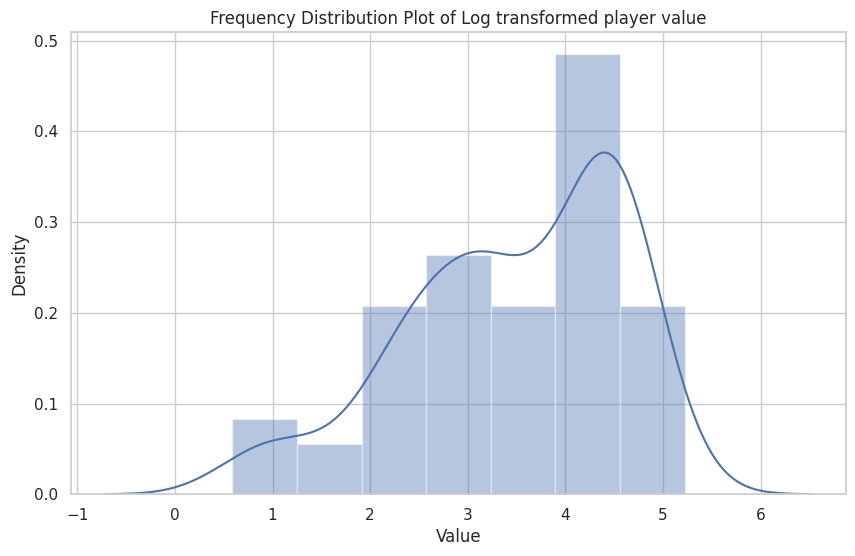

In [ ]:
x = player_list.Value
x = np.log(x)
sns.set(style="whitegrid")
plt.figure(figsize=(10,6))
sns.distplot(x).set_title('Frequency Distribution Plot of Log transformed player value')
plt.show()

In [ ]:
player_list["Value_log"] = np.log(player_list["Value"])
player_list

,Name,Value,Age,Overall,Potential,Height,Weight,Foot,Best_Overall,Growth,Wage,Release_Clause,Attacking,Crossing,Finishing,Heading_Accuracy,Short_Passing,Volleys,Skill,Dribbling,Curve,FK_Accuracy,Long_Passing,Ball_Control,Movement,Acceleration,Sprint_Speed,Agility,Reactions,Balance,Power,Shot_Power,Jumping,Stamina,Strength,Long_Shots,Mentality,...,Team_Manchester United,Team_Milan,Team_Napoli,Team_OGC Nice,Team_Orlando City SC,Team_PFC CSKA Moscow,Team_PSV,Team_Paris Saint-Germain,Team_RB Leipzig,Team_Real Betis,Team_Real Madrid,Team_SK Rapid Wien,Team_Santos Laguna,Team_Sevilla FC,Team_Spartak Moscow,Team_Sporting CP,Team_Stade Brestois 29,Team_Stade Rennais FC,Team_Tottenham Hotspur,Team_Valencia CF,Team_VfL Wolfsburg,Team_West Bromwich Albion,Team_Wolverhampton Wanderers,Position_ CAM,Position_ CB,Position_ CDM,Position_ CM,Position_ GK,Position_ LM,Position_ LW,Position_ LWB,Position_ RB,Position_ RM,Position_ RW,Position_ RWB,Position_ ST,Value_log
0,T. Tomiyasu,12.0,21,75,85,188.0,84.0,Right,77,10,0.019,24.0,261,62,29,69,71,30,290,68,48,37,66,71,350,71,68,70,71,70,291,42,69,75,77,28,283,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2.484907
1,D. Rossi,17.0,22,76,84,170.0,68.0,Right,77,8,0.009,28.9,331,67,77,44,72,71,315,75,72,34,57,77,405,83,82,83,73,84,335,75,58,79,54,69,279,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2.833213
2,E. Camavinga,29.0,17,78,89,183.0,68.0,Left,80,11,0.006,60.9,336,70,62,64,81,59,369,80,72,59,77,81,379,74,72,79,78,76,358,72,68,79,75,64,365,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,3.367296
3,Junior Messias,1.8,29,71,71,178.0,70.0,Left,71,0,0.009,3.2,320,65,69,52,74,60,361,78,71,73,66,73,346,75,69,66,68,68,301,68,53,64,52,64,279,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0.587787
4,Emerson,27.0,21,78,85,180.0,79.0,Right,78,7,0.017,62.1,323,75,57,70,77,44,332,72,73,47,65,75,376,79,79,74,75,69,370,77,78,79,74,62,334,...,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,3.295837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,De Gea,46.5,29,86,86,193.0,82.0,Right,86,0,0.150,88.4,112,17,13,21,48,13,139,18,21,19,43,38,305,57,58,63,84,43,234,57,67,43,55,12,170,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,3.839452
105,R. Lukaku,73.5,27,86,86,190.0,94.0,Left,86,0,0.175,125.0,402,73,88,87,77,77,372,78,78,66,70,80,355,78,84,60,87,46,400,87,71,73,95,74,348,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,4.297285
106,A. Maitland-Niles,8.5,22,75,81,178.0,70.0,Right,77,6,0.049,0.0,296,69,58,50,75,44,322,78,64,36,68,76,387,79,83,79,75,71,344,72,55,82,69,66,356,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2.140066
107,M. Kean,31.0,20,78,86,183.0,72.0,Right,80,8,0.062,0.0,339,42,81,76,68,72,304,80,67,43,38,76,392,83,84,74,73,78,372,84,75,70,83,60,286,...,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,3.433987


In [ ]:
Xs= player_list.drop(columns=["Value","Value_log","Name","Foot"])#.loc[:,['Overall','Age','Weight','Height','Growth','Release_Clause']]
ys= player_list.loc[:,"Value_log"]

#Split data train (%60), test(%20) and validation (%20)
X, X_test, y, y_test = train_test_split(Xs,ys,test_size=0.2, random_state=10)

X_train, X_val, y_train, y_val = train_test_split(X,y, test_size=.25, random_state=10)


lm = LinearRegression()
xgb_reg = XGBRegressor()
#Feature scaling for train, val, and test so that we can run our ridge model on each
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train.values)
X_val_scaled = scaler.transform(X_val.values)
X_test_scaled = scaler.transform(X_test.values)

lm_reg = Ridge(alpha=0.05, normalize=True)

lm_lasso = Lasso(alpha=0.05, normalize=True)



#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=2)

Xs_poly = poly.fit_transform(X.values)
X_train_poly = poly.fit_transform(X_train.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_test.values)

lm_poly = LinearRegression()

lm.fit(X_train, y_train)
print(f'Linear Regression for all data R^2: {lm.score(Xs, ys):.6f}')
print(f'Linear Regression for test data R^2: {lm.score(X_test, y_test):.6f}')
print(f'Linear Regression for validation data R^2: {lm.score(X_val, y_val):.6f}')
print("")

lm_reg.fit(X_train_scaled, y_train)
print(f'Ridge Regression for test data R^2: {lm_reg.score(X_test_scaled, y_test):.6f}')
print(f'Ridge Regression for validation data R^2: {lm_reg.score(X_val_scaled, y_val):.6f}')
print("")


lm_lasso.fit(X_train,y_train)
print(f'Lasso Regression for test data R^2: {lm_lasso.score(X_test, y_test):.6f}')
print(f'Lasso Regression for validation data R^2: {lm_lasso.score(X_val, y_val):.6f}')
print("")

lm_poly.fit(X_train_poly, y_train)
print(f'Degree 2 polynomial regression for test data R^2: {lm_poly.score(X_test_poly, y_test):.6f}')
print(f'Degree 2 polynomial regression for validation data R^2: {lm_poly.score(X_val_poly, y_val):.6f}')
print("")


eval_set = [(X_train, y_train), (X_test, y_test)]

xgb_reg.fit(X_train, y_train, eval_set = eval_set, verbose=0)

y_test_pred = xgb_reg.predict(X_test)
y_val_pred = xgb_reg.predict(X_val)

print(f'XGBoost regression for test data R^2: {r2_score(y_test_pred, y_test):.3f}')
print(f'XGBoost regression for validayion data R^2: {r2_score(y_val_pred, y_val):.3f}')
print("")
gbm.fit(X_train, y_train, eval_set = eval_set, verbose=0)
y_test_pred = gbm.predict(X_test)
y_val_pred = gbm.predict(X_val)

print(f'LGBM regression for test data R^2: {r2_score(y_test_pred, y_test):.3f}')
print(f'LGBM regression for validayion data R^2: {r2_score(y_val_pred, y_val):.3f}')
print("")


model = ann_model(len(X_train.columns))

scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()


scaler_x.fit(X_train)
xtrain_scale=scaler_x.transform(X_train)
scaler_x.fit(X_val)
xval_scale=scaler_x.transform(X_val)
scaler_x.fit(X_test)
xtest_scale=scaler_x.transform(X_test)
scaler_y.fit(y_train.to_numpy().reshape(-1,1))
ytrain_scale=scaler_y.transform(y_train.to_numpy().reshape(-1,1))
scaler_y.fit(y_val.to_numpy().reshape(-1,1))
yval_scale=scaler_y.transform(y_val.to_numpy().reshape(-1,1))
scaler_y.fit(y_test.to_numpy().reshape(-1,1))
ytest_scale=scaler_y.transform(y_test.to_numpy().reshape(-1,1))

logdir = "logs/scalars/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

history=model.fit(xtrain_scale,
                  ytrain_scale,
                  epochs=100,
                  verbose=0,
                  validation_split=0.2,
                  validation_data=(xtest_scale, ytest_scale),
                  callbacks=[tensorboard_callback]
)


y_test_pred = model.predict(xtest_scale)

y_val_pred = model.predict(xval_scale)


print(f'ANN regression for test data R^2: {r2_score(y_test_pred, ytest_scale):.3f}')
print(f'ANN regression for validayion data R^2: {r2_score(y_val_pred, yval_scale):.3f}')


Linear Regression for all data R^2: 0.230404
Linear Regression for test data R^2: 0.818036
Linear Regression for validation data R^2: -5.340131

Ridge Regression for test data R^2: 0.834793
Ridge Regression for validation data R^2: 0.458980

Lasso Regression for test data R^2: 0.700566
Lasso Regression for validation data R^2: 0.501869

Degree 2 polynomial regression for test data R^2: 0.774121
Degree 2 polynomial regression for validation data R^2: 0.165415

[16:17:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
XGBoost regression for test data R^2: 0.949
XGBoost regression for validayion data R^2: 0.897

LGBM regression for test data R^2: 0.884
LGBM regression for validayion data R^2: 0.904

ANN regression for test data R^2: 0.793
ANN regression for validayion data R^2: 0.242


In [ ]:
%tensorboard --logdir logs/scalars

Reusing TensorBoard on port 6006 (pid 690), started 0:00:09 ago. (Use '!kill 690' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Run Cross Validation
kf = KFold(n_splits=10, shuffle=True, random_state = 16)
cross_val_score(lm, Xs, ys, cv=kf, scoring='r2')

print('Linear Regression:',round(np.mean(cross_val_score(lm, Xs, ys, cv=kf, scoring='r2')),5))
print('Ridge Regression:',round(np.mean(cross_val_score(lm_reg, Xs, ys, cv=kf, scoring='r2')),5))
print('Lasso Regression:',round(np.mean(cross_val_score(lm_lasso, Xs, ys, cv=kf, scoring='r2')),5))
print('Degree 2 Poly. Regression:',round(np.mean(cross_val_score(lm_poly, Xs, ys, cv=kf, scoring='r2')),5))
print('XGB Regression:',round(np.mean(cross_val_score(xgb_reg, Xs, ys, cv=kf, scoring='r2')),5))
print('LGBM Regression:',round(np.mean(cross_val_score(gbm, X1, y1, cv=kf, scoring='r2')),5))

Linear Regression: 0.45736
Ridge Regression: 0.79966
Lasso Regression: 0.62052
Degree 2 Poly. Regression: 0.45736
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:17:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederro